# <center> Dynamic Modeling with Big Data: <br> Large Company Stock Predictions

    
Name: [Math & Physics Fun With Gus](https://mathphysicsfunwithgus.square.site)<br>
Date: 11/11/2022


In [1]:
# General Imports
import matplotlib.pyplot as pl
import statsmodels.api as sm
import seaborn as sns
import pandas as pd
import numpy as np

import statsmodels.formula.api as smf
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Nice plot imports
%config InlineBackend.figure_format = 'retina'

# LaTeX font on plots
pl.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": ["Helvetica"]})
# for Palatino and other serif fonts use:
pl.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Palatino"]})

pl.style.use("fivethirtyeight")
pl.rc("figure", autolayout=True)
pl.rc("axes",
      labelweight="bold",
      labelsize="large",
      titleweight="bold",
      titlesize=14,
      titlepad=10)

# General Plot Settings
plot_dim = (8, 4.75)
sns.set_style('whitegrid')

COLORS = ['blue', 'gold', 'darkorange', 'green', 'dodgerblue',
          'blueviolet', 'turquoise', 'darkgray', 'C1', 'darkcyan']

In [2]:
# LaTeX table function
def latex_it(table, name: str):
    with open(name + '.tex', 'w') as tf:
        tf.write(table.style.to_latex())

# Statistical Functions

In [3]:
#####################################################
####     VIF calculator for multicollinearity    ####
#####################################################
def VIF_calculator(df, model: str):
    
    from patsy import dmatrices
    from statsmodels.stats.outliers_influence import variance_inflation_factor

    #find design matrix for linear regression model using 'rating' as response variable 
    y, X = dmatrices(model, data=df, return_type='dataframe')

    #calculate VIF for each explanatory variable
    vif = pd.DataFrame()
    vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    vif['variable'] = X.columns
    
    return vif


#####################################################
#   Stationarity test: Computes Dicky-Fuller Test   #
#####################################################
def D_fuller_test(df, column='y'):
    
    """
    Dicky-Fuller Test (Stationarity test)

    Hypothesis to prove dicky-fuller tests
    H0: alpha = 1; Time-Series is non-stationary
    HA: alpha < 1; Time-series is stationary
    """
    
    from statsmodels.tsa.stattools import adfuller
    
    adfuller_result = adfuller(df[column], autolag='AIC')
    adfuller_output = pd.Series(adfuller_result[:4],
                                index=['Test statistic',
                                       'p-value',
                                       'Lags Used',
                                       'Number of Observations Used'])
    return adfuller_output


#####################################################
####      Function which plots ACF and PACF      ####
#####################################################
def acf_pacf(data, lag: int, column='y', dim=(9, 5)):
    
    from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
    
    f = pl.figure()
    
    # plot the acf plot
    ax0 = f.add_subplot(121)
    plot_acf(data, lags=lag, ax=ax0)
    
    # plot the pacf plots
    ax1 = f.add_subplot(122)
    plot_pacf(data, lags=lag, method='ywm', ax=ax1)
    pl.show()

## Importing, Cleaning, and Checking Data

In [4]:
##########################################################
#############         Importing Data         #############
##########################################################
df = pd.read_csv("sp500_stocks.csv")
df_index = pd.read_csv("sp500_index.csv")

In [5]:
#####################################################
# function for to clean column names
#####################################################
def CleanColumnHeading(dfx):
    """
    Function that takes data frame 
    in and returns data frame with
    cleaned column names:' ','-'->'_' 
    and upper case -> lower case.
    """
    
    # chaning to lower case
    dfx = dfx.rename(columns=str.lower)
    
    # chaning " " -> "_"
    dfx = dfx.rename(columns={col: col.replace(" ", "_") for col in dfx.columns})
    dfx = dfx.rename(columns={col: col.replace("-", "_") for col in dfx.columns})
    
    return dfx

#####################################################
# function to get all the gerneral df info
#####################################################
def info_data(df, stock_name='symbol', stock_date='date'):
    
    # unique stocks
    print("Uniques stocks in dataset:", df[stock_name].nunique())
    print("----"*15)
    
    # metadata of dataset
    print("Metadata of the dataset:\n")
    df.info()
    print("----"*15)
    
    # missing values
    print('Null sum in columns:\n')
    print(df.isnull().sum())
    print("----"*15)
    
    # max range of stocks dataset
    delta = pd.to_datetime(df[stock_date]).max() - pd.to_datetime(df[stock_date]).min()
    print("Time range of stocks dataset:\n", delta)
    print("----"*15) 

#### Percent Change of a Stock's Price is given by
$$\texttt{Percent Change} = 100\left(\frac{\texttt{Close Price} - \texttt{Open Price}}{\texttt{Open Price}}\right)$$

In [38]:
##########################################################
#############         Stocks cleaning        #############
##########################################################
df = CleanColumnHeading(df)
df.date = pd.to_datetime(df.date)
df.dropna(inplace=True)

##########################################################
#   Adding Percent change column and Daily Mean column   #
##########################################################
# formula for percentage change is: (New Price - Old Price) / Old Price x 100
df['percent_change'] = ((df.close - df.open) / df.open)*100
df['daily_mean'] = (df.open + df.close + df.high + df.low) / 4
info_data(df)

Uniques stocks in dataset: 503
------------------------------------------------------------
Metadata of the dataset:

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1559483 entries, 0 to 1628713
Data columns (total 10 columns):
 #   Column          Non-Null Count    Dtype         
---  ------          --------------    -----         
 0   date            1559483 non-null  datetime64[ns]
 1   symbol          1559483 non-null  object        
 2   adj_close       1559483 non-null  float64       
 3   close           1559483 non-null  float64       
 4   high            1559483 non-null  float64       
 5   low             1559483 non-null  float64       
 6   open            1559483 non-null  float64       
 7   volume          1559483 non-null  float64       
 8   percent_change  1559483 non-null  float64       
 9   daily_mean      1559483 non-null  float64       
dtypes: datetime64[ns](1), float64(8), object(1)
memory usage: 130.9+ MB
------------------------------------------------

# Finding Top Traded Stocks

#### Top tech stocks in S&P 500 top 10 are apple, tsla, amzn, googl, goog, nvda, amd, t. Plus the other top tech in S&P 500: msft, meta, intc 

In [7]:
#####################################################
# Computes top or bottom traded stocks in dateframe
#####################################################
def end_stocks(df_stocks, symbol_col='symbol', volume_col='volume', bottom=False):
    """
    Find the average volume of each stocks
    using function and sort top 15 most
    traded stocks for further analysis.
    If top15=False -> Least traded stocks
    in dataframe.
    """ 
    mean_dict = {}

    # find average of volume traded over a period of time using for loops
    for key in df_stocks[symbol_col].unique():
        value = df_stocks[df_stocks[symbol_col] == key][volume_col].mean()
        mean_dict[key] = value

    print("Length of the mean of stock dictionary:", len(mean_dict))

    # convert dict to pandas dataframe
    average_s = pd.Series(mean_dict).transpose()
    endstocks = average_s.sort_values(ascending=bottom)[:15]

    if not bottom:
        print("Top 10 company stocks with highest average traded stock volume:\n", endstocks.index)
        
    else:
        print("Top 10 company stocks with lowest average traded stock volume:\n", endstocks.index)

In [8]:
# finding top stocks by mean volume
end_stocks(df)

Length of the mean of stock dictionary: 503
Top 10 company stocks with highest average traded stock volume:
 Index(['AAPL', 'BAC', 'TSLA', 'AMZN', 'GOOGL', 'GOOG', 'F', 'NVDA', 'AMD', 'T',
       'MSFT', 'INTC', 'PFE', 'CSCO', 'META'],
      dtype='object')


In [8]:
# company dict for respective ticks (TOP 10 STOCKS BY AVERAGE TRAE VOLUME)
tech_names = ['Apple',
              'Amazon',
              'Tesla',
              'Alphabet Inc Class A',
              'Alphabet Inc Class C',
              'NVIDIA Corporation',
              'Adavanced Micro Devices', 
              'AT\&T Inc.', 
              'Mircosoft',
              'Intel']

tech_symbols = ['AAPL', 'AMZN', 'TSLA', 'GOOGL', 'GOOG',
                'NVDA', 'AMD', 'T', 'MSFT', 'INTC']

### Formatting Data

In [9]:
#####################################################
###  Edit Column Names -> To create on DataFrame  ###
#####################################################
def column_name_edit(df, add_to_name: str, skip_col_1=True, date='date'):
    """
    Appends name to inputed data frame
    columns. It assumes the first column
    is a data-time column.
    """
    df_copy = df.copy()
    
    if add_to_name in df.columns[1]:
        pass
    
    else:
        if skip_col_1:
            df_copy.columns = [date] + [f'{add_to_name}_' + col for col in df_copy.columns[1:]] 
            
        else:
            df_copy.columns = [f'{add_to_name}_' + col for col in df_copy.columns]
            
    return df_copy


In [10]:
#####################################################
####    Forming One dataframe aranged by time    ####
#####################################################
df_tech = column_name_edit(df[df.symbol == tech_symbols[0]], tech_symbols[0]);df_tech

for symbol in tech_symbols[1:]:
    df_tech = df_tech.merge( column_name_edit(df[df.symbol == symbol], symbol) )

# Dropping NA anywhere
df_tech.dropna(inplace=True)

# Removing symbol columns
columns_good = [col for col in df_tech.columns if not 'symbol' in col]
df_tech = df_tech[columns_good]

In [11]:
# Getting column names with closing values and percent change
close_columns =  ['date'] + [col for col in df_tech.columns if 'close' in col and not 'adj' in col]
pc_columns = ['date'] + [col for col in df_tech.columns if 'percent_chang' in col]
da_columns = ['date'] + [col for col in df_tech.columns if 'daily_mean' in col]

# Top Tech Data Analysis

In [12]:
#####################################################
# Shows stocks
#####################################################
def stock_data_show(df):
    
    fun_col_dict = {'background-color': 'midnightblue',
                    'color': 'lawngreen',
                    'border': '1.5px  white'}
    
    return df.style.set_properties(**fun_col_dict)

In [13]:
display(stock_data_show(df_tech.head(4)),
        stock_data_show(df_tech.tail(4)))

,date,AAPL_adj_close,AAPL_close,AAPL_high,AAPL_low,AAPL_open,AAPL_volume,AAPL_percent_change,AAPL_daily_mean,AMZN_adj_close,AMZN_close,AMZN_high,AMZN_low,AMZN_open,AMZN_volume,AMZN_percent_change,AMZN_daily_mean,TSLA_adj_close,TSLA_close,TSLA_high,TSLA_low,TSLA_open,TSLA_volume,TSLA_percent_change,TSLA_daily_mean,GOOGL_adj_close,GOOGL_close,GOOGL_high,GOOGL_low,GOOGL_open,GOOGL_volume,GOOGL_percent_change,GOOGL_daily_mean,GOOG_adj_close,GOOG_close,GOOG_high,GOOG_low,GOOG_open,GOOG_volume,GOOG_percent_change,GOOG_daily_mean,NVDA_adj_close,NVDA_close,NVDA_high,NVDA_low,NVDA_open,NVDA_volume,NVDA_percent_change,NVDA_daily_mean,AMD_adj_close,AMD_close,AMD_high,AMD_low,AMD_open,AMD_volume,AMD_percent_change,AMD_daily_mean,T_adj_close,T_close,T_high,T_low,T_open,T_volume,T_percent_change,T_daily_mean,MSFT_adj_close,MSFT_close,MSFT_high,MSFT_low,MSFT_open,MSFT_volume,MSFT_percent_change,MSFT_daily_mean,INTC_adj_close,INTC_close,INTC_high,INTC_low,INTC_open,INTC_volume,INTC_percent_change,INTC_daily_mean
0,2010-06-29 00:00:00,7.867194,9.148929,9.442500,9.082143,9.432857,1133344800.000000,-3.009989,9.276607,5.430500,5.430500,5.824000,5.300500,5.813000,257326000.000000,-6.580082,5.592000,1.592667,1.592667,1.666667,1.169333,1.266667,281494500.000000,25.736833,1.423833,11.367868,11.367868,11.625375,11.289289,11.597598,139943916.000000,-1.980838,11.470033,11.314092,11.314092,11.570381,11.235885,11.542735,140609069.000000,-1.980843,11.415773,2.407478,2.620000,2.717500,2.602500,2.715000,66080800.000000,-3.499080,2.663750,7.480000,7.480000,7.930000,7.410000,7.930000,43861400.000000,-5.674651,7.687500,7.345033,18.474319,18.806646,18.330816,18.776436,69971944.000000,-1.609019,18.597054,18.237944,23.309999,24.200001,23.110001,24.129999,119882100.000000,-3.398258,23.687500,14.213812,19.790001,20.049999,19.650000,20.000000,79050800.000000,-1.049995,19.872500
1,2010-06-30 00:00:00,7.724693,8.983214,9.213214,8.928929,9.168214,739452000.000000,-2.017835,9.073393,5.463000,5.463000,5.634000,5.405500,5.429000,194814000.000000,0.626265,5.482875,1.588667,1.588667,2.028000,1.553333,1.719333,257806500.000000,-7.599808,1.722333,11.134885,11.134885,11.457207,11.129129,11.385385,143983872.000000,-2.200187,11.276651,11.082211,11.082211,11.403009,11.076483,11.331527,144668227.000000,-2.200200,11.223307,2.345454,2.552500,2.652500,2.552500,2.625000,62307200.000000,-2.761904,2.595625,7.320000,7.320000,7.650000,7.300000,7.580000,26406200.000000,-3.430076,7.462500,7.263959,18.270393,18.459215,18.209970,18.391239,49244591.000000,-0.657083,18.332705,18.003220,23.010000,23.680000,22.950001,23.299999,81050500.000000,-1.244631,23.235000,13.969616,19.450001,20.030001,19.400000,19.700001,64294700.000000,-1.269035,19.645000
2,2010-07-01 00:00:00,7.631024,8.874286,9.100000,8.686429,9.082143,1022896000.000000,-2.288635,8.935714,5.548000,5.548000,5.584500,5.335000,5.445000,170596000.000000,1.891638,5.478125,1.464000,1.464000,1.728000,1.351333,1.666667,123282000.000000,-12.160018,1.552500,10.998248,10.998248,11.221221,10.851602,11.143393,140403456.000000,-1.302516,11.053616,10.946221,10.946221,11.168139,10.800268,11.090679,141070793.000000,-1.302516,11.001327,2.384506,2.595000,2.612500,2.482500,2.560000,73700800.000000,1.367191,2.562500,7.390000,7.390000,7.530000,7.100000,7.350000,27289900.000000,0.544217,7.342500,7.309000,18.383686,18.429003,18.126888,18.323263,67766027.000000,0.329761,18.315710,18.120586,23.160000,23.320000,22.730000,23.090000,92239400.000000,0.303160,23.075000,13.825966,19.250000,19.620001,19.000000,19.430000,88020000.000000,-0.926404,19.325000
3,2010-07-02 00:00:00,7.583732,8.819286,8.961786,8.685714,8.946071,693842800.000000,-1.417207,8.853214,5.457000,5.457000,5.564500,5.428000,5.546000,89542000.000000,-1.604764,5.498875,1.280000,1.280000,1.540000,1.247333,1.533333,77097000.000000,-16.521720,1.400166,10.924675,10.924675,11.068068,10.910911,11.051552,77362560.000000,-1.148045,10.988801,10.872995,10.872995,11.015710,10.859297,10.999272,77730264.000000,-1.148

,date,AAPL_adj_close,AAPL_close,AAPL_high,AAPL_low,AAPL_open,AAPL_volume,AAPL_percent_change,AAPL_daily_mean,AMZN_adj_close,AMZN_close,AMZN_high,AMZN_low,AMZN_open,AMZN_volume,AMZN_percent_change,AMZN_daily_mean,TSLA_adj_close,TSLA_close,TSLA_high,TSLA_low,TSLA_open,TSLA_volume,TSLA_percent_change,TSLA_daily_mean,GOOGL_adj_close,GOOGL_close,GOOGL_high,GOOGL_low,GOOGL_open,GOOGL_volume,GOOGL_percent_change,GOOGL_daily_mean,GOOG_adj_close,GOOG_close,GOOG_high,GOOG_low,GOOG_open,GOOG_volume,GOOG_percent_change,GOOG_daily_mean,NVDA_adj_close,NVDA_close,NVDA_high,NVDA_low,NVDA_open,NVDA_volume,NVDA_percent_change,NVDA_daily_mean,AMD_adj_close,AMD_close,AMD_high,AMD_low,AMD_open,AMD_volume,AMD_percent_change,AMD_daily_mean,T_adj_close,T_close,T_high,T_low,T_open,T_volume,T_percent_change,T_daily_mean,MSFT_adj_close,MSFT_close,MSFT_high,MSFT_low,MSFT_open,MSFT_volume,MSFT_percent_change,MSFT_daily_mean,INTC_adj_close,INTC_close,INTC_high,INTC_low,INTC_open,INTC_volume,INTC_percent_change,INTC_daily_mean
3112,2022-11-07 00:00:00,138.919998,138.919998,139.149994,135.669998,137.110001,83374600.000000,1.320106,137.712498,90.529999,90.529999,92.099998,89.040001,91.949997,77495700.000000,-1.544316,90.904999,197.080002,197.080002,208.899994,196.660004,208.649994,93916500.000000,-5.545168,202.822498,88.489998,88.489998,88.900002,86.849998,87.279999,34078900.000000,1.386342,87.879999,88.650002,88.650002,88.940002,86.959999,87.339996,26899900.000000,1.499892,87.972500,143.009995,143.009995,144.119995,139.539993,142.279999,41006100.000000,0.513070,142.237495,63.080002,63.080002,63.529999,61.400002,62.930000,62722500.000000,0.238363,62.735001,18.360001,18.360001,18.400000,18.150000,18.340000,39985200.000000,0.109054,18.312500,227.869995,227.869995,228.410004,221.279999,221.990005,33498000.000000,2.648763,224.887501,28.410000,28.410000,28.469999,27.889999,28.360001,34389800.000000,0.176302,28.282500
3113,2022-11-08 00:00:00,139.500000,139.500000,141.429993,137.490005,140.410004,89908500.000000,-0.648105,139.707500,89.980003,89.980003,91.720001,88.230003,90.790001,88703400.000000,-0.892166,90.180002,191.300003,191.300003,195.199997,186.750000,194.020004,128803400.000000,-1.401918,191.817501,88.900002,88.900002,90.320000,87.589996,88.900002,30429000.000000,0.000000,88.927500,88.910004,88.910004,90.404999,87.650002,89.160004,30172000.000000,-0.280395,89.031252,146.020004,146.020004,148.910004,142.160004,148.009995,59529200.000000,-1.344497,146.275002,63.849998,63.849998,64.959999,62.369999,64.089996,75938000.000000,-0.374470,63.817498,18.570000,18.570000,18.730000,18.299999,18.379999,43210400.000000,1.033735,18.494999,228.869995,228.869995,231.649994,225.839996,228.699997,28192500.000000,0.074332,228.764996,28.480000,28.480000,28.950001,27.930000,28.760000,36258000.000000,-0.973577,28.530000
3114,2022-11-09 00:00:00,134.869995,134.869995,138.550003,134.589996,138.500000,74917800.000000,-2.620942,136.627499,86.139999,86.139999,89.480003,85.870003,89.470001,90796200.000000,-3.721920,87.740002,177.589996,177.589996,195.889999,177.119995,190.779999,127062700.000000,-6.913724,185.344997,87.320000,87.320000,89.440002,87.279999,88.449997,31769100.000000,-1.277555,88.122499,87.400002,87.400002,89.489998,87.360001,88.544998,26743900.000000,-1.293124,88.198750,137.759995,137.759995,142.110001,137.589996,141.619995,45441400.000000,-2.725604,139.769997,59.919998,59.919998,63.049999,59.799999,62.279999,62940300.000000,-3.789340,61.262499,18.379999,18.379999,18.719999,18.379999,18.480000,41838400.000000,-0.541128,18.489999,224.509995,224.509995,228.630005,224.330002,227.369995,27852900.000000,-1.257862,226.209999,27.520000,27.520000,28.299999,27.520000,28.219999,30544800.000000,-2.480506,27.890000
3115,2022-11-10 00:00:00,146.869995,146.869995,146.869995,139.500000,141.240005,118304026.000000,3.986115,143.619999,96.629997,96.629997,98.690002,91.650002,92.934998,171736985.000000,3.975897,94.976250,190.720001,190.720001,191.000000,180.029999,189.899994,132173444.00

### Plotting Closing Price of Big Tech

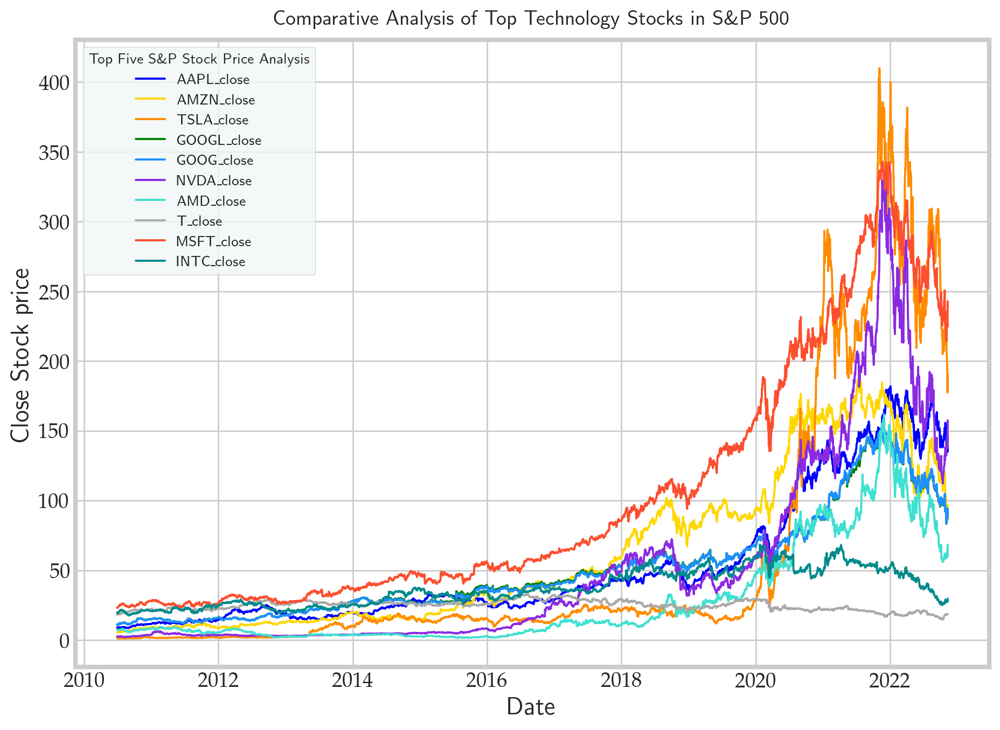

In [14]:
# tech stocks price comparison
fig, ax = pl.subplots(figsize=(9.5,7))
for i, col in enumerate(df_tech[close_columns].set_index('date')):
    ax.plot(df_tech.date,
            df_tech[col],
            label=col,
            color=COLORS[i],
            lw=1.4)

ax.set_title("Comparative Analysis of Top Technology Stocks in S\&P 500")
ax.set_xlabel("Date")
ax.set_ylabel("Close Stock price")
ax.legend(facecolor='#f2f7f7',
          fontsize="x-small",
          title="Top Five S\&P Stock Price Analysis",
          title_fontsize=10)
pl.show()

In [37]:
# Mircosoft has highest value with apple
display( stock_data_show(df_tech[close_columns].corr()) )
#sns.pairplot(df_tech[close_columns])

# Mircosoft has highest value with apple
display( stock_data_show(df_tech[pc_columns].corr()) )
#sns.pairplot(df_tech[pc_columns])

,AAPL_close,AMZN_close,TSLA_close,GOOGL_close,GOOG_close,NVDA_close,AMD_close,T_close,MSFT_close,INTC_close
AAPL_close,1.000000,0.925523,0.954689,0.965257,0.966443,0.962481,0.967327,-0.563352,0.983718,0.653002
AMZN_close,0.925523,1.000000,0.821906,0.942769,0.943575,0.904121,0.917079,-0.452703,0.960544,0.836776
TSLA_close,0.954689,0.821906,1.000000,0.910979,0.912678,0.947392,0.943374,-0.615538,0.919321,0.480949
GOOGL_close,0.965257,0.942769,0.910979,1.000000,0.999839,0.964165,0.940082,-0.460247,0.981438,0.741275
GOOG_close,0.966443,0.943575,0.912678,0.999839,1.000000,0.965212,0.942000,-0.466121,0.982573,0.739247
NVDA_close,0.962481,0.904121,0.947392,0.964165,0.965212,1.000000,0.972309,-0.569428,0.963999,0.634806
AMD_close,0.967327,0.917079,0.943374,0.940082,0.942000,0.972309,1.000000,-0.598849,0.972193,0.635562
T_close,-0.563352,-0.452703,-0.615538,-0.460247,-0.466121,-0.569428,-0.598849,1.000000,-0.537454,-0.107670
MSFT_close,0.983718,0.960544,0.919321,0.981438,0.982573,0.963999,0.972193,-0.537454,1.000000,0.735771
INTC_close,0.653002,0.836776,0.480949,0.741275,0.739247,0.634806,0.635562,-0.107670,0.735771,1.000000


,AAPL_percent_change,AMZN_percent_change,TSLA_percent_change,GOOGL_percent_change,GOOG_percent_change,NVDA_percent_change,AMD_percent_change,T_percent_change,MSFT_percent_change,INTC_percent_change
AAPL_percent_change,1.000000,0.530026,0.336984,0.586793,0.585636,0.505925,0.385667,0.270311,0.582538,0.466075
AMZN_percent_change,0.530026,1.000000,0.366410,0.651607,0.647933,0.503434,0.393747,0.214402,0.561418,0.426710
TSLA_percent_change,0.336984,0.366410,1.000000,0.353290,0.348659,0.364336,0.314587,0.101651,0.312756,0.262334
GOOGL_percent_change,0.586793,0.651607,0.353290,1.000000,0.986012,0.536538,0.378725,0.281474,0.648293,0.469426
GOOG_percent_change,0.585636,0.647933,0.348659,0.986012,1.000000,0.531677,0.373965,0.280950,0.644574,0.468385
NVDA_percent_change,0.505925,0.503434,0.364336,0.536538,0.531677,1.000000,0.546898,0.182471,0.560558,0.517334
AMD_percent_change,0.385667,0.393747,0.314587,0.378725,0.373965,0.546898,1.000000,0.162352,0.406997,0.406680
T_percent_change,0.270311,0.214402,0.101651,0.281474,0.280950,0.182471,0.162352,1.000000,0.305751,0.312964
MSFT_percent_change,0.582538,0.561418,0.312756,0.648293,0.644574,0.560558,0.406997,0.305751,1.000000,0.553394
INTC_percent_change,0.466075,0.426710,0.262334,0.469426,0.468385,0.517334,0.406680,0.312964,0.553394,1.000000


In [16]:
#####################################################
# Great Data Analysis function
#####################################################
def Report(data):
    
    from dataprep.eda import create_report
    import warnings
    warnings.filterwarnings('ignore')
    
    report_data = create_report(data)
    return report_data

In [35]:
#Report(df_tech[close_columns])

In [36]:
#Report(df_tech[pc_columns])

### Analysis of Max Values, and Occerence

In [19]:
#####################################################
# function return closing stock price in time period
#####################################################
def closing_stock_price(df, col, date='date'):
    """
    Plots closeing price stock value 
    over period color around plot changes
    if highest price was not withing certian
    time interval
    """
    
    # define highest stock over in time with date of the same
    high = df[col].max()
    datetime = df[df[col] == df[col].max()]['date'].values
    
    # Time intervals
    last_year = pd.to_datetime('2021-01-01')
    this_year = pd.to_datetime('2022-01-01')
    
    # check to see if of max value occured this year
    if datetime[0] >= this_year:
        fig, ax = pl.subplots(figsize=(8, 4.5), facecolor='limegreen')
        
    elif last_year < datetime[0] < this_year:
        fig, ax = pl.subplots(figsize=(8, 4.5), facecolor='orange')
        
    elif datetime[0] <= last_year:
        fig, ax = pl.subplots(figsize=(8, 4.5), facecolor='r')
        
    ax.plot(df[date], df[col], color='darkslategrey')
    pl.axvline(pd.to_datetime('2020-03-11'), label='COVID lockdown Date', linewidth=0.5)
    ax.set_title(f"{col} stock price", fontsize=20)
    ax.set_xlabel("Date", fontsize=15)
    ax.set_ylabel("Daily closing stock price", fontsize=15)
    ax.annotate(f"All time high price during\ntwelve year period\nwas \
                \${round(high, 5)} and \n{str(datetime[0])[0:10]}",
                xy=(datetime, high),
                xytext=(datetime - np.timedelta64(1500, 'D'), high - high/3),
                bbox=dict(boxstyle="round", facecolor='white', edgecolor='blue'),
                fontsize=10,
                arrowprops=dict(facecolor='red', headlength=25, shrink=0.1))
    pl.show()

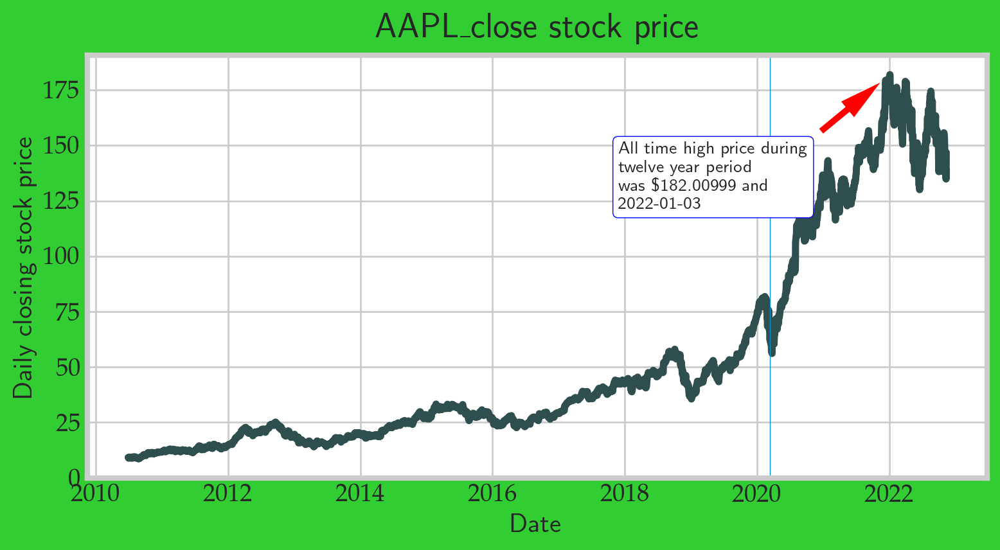

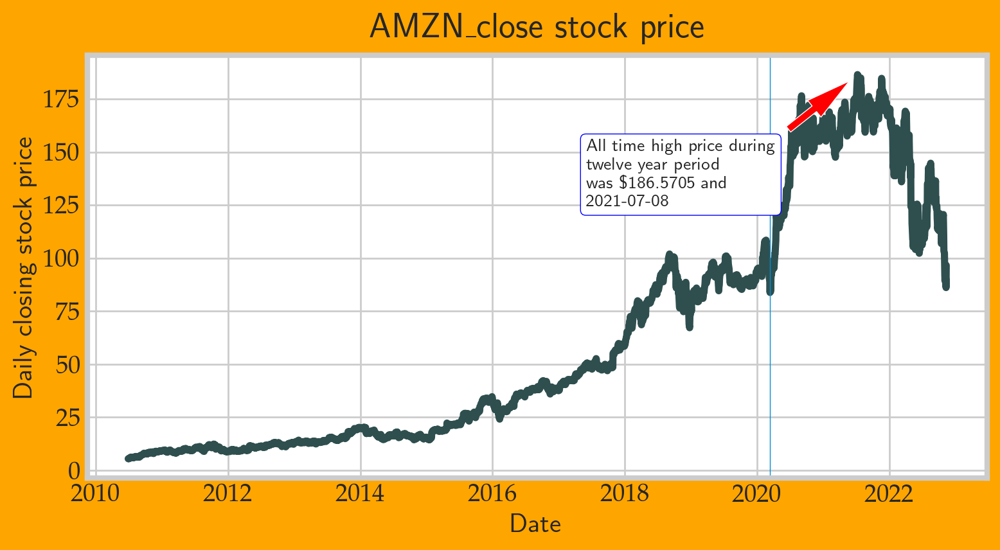

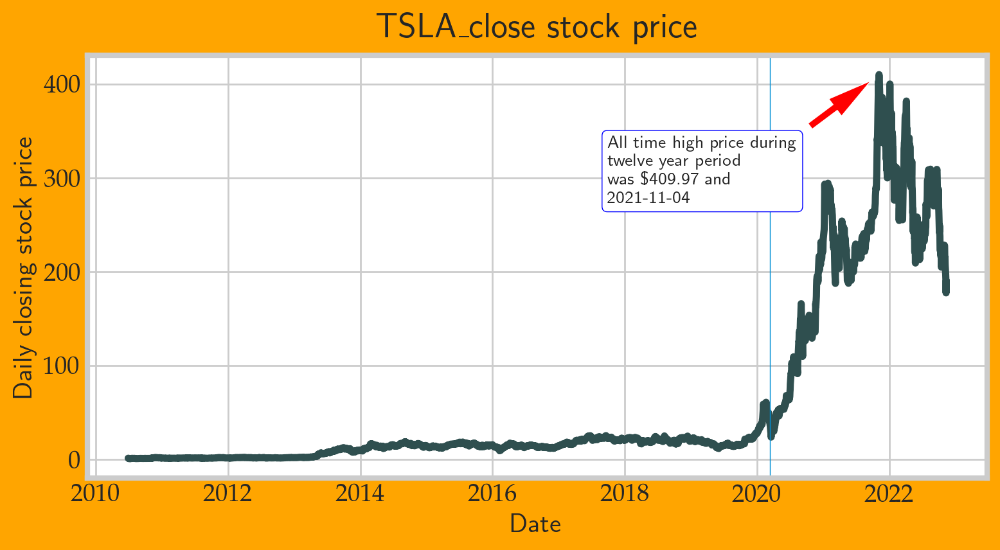

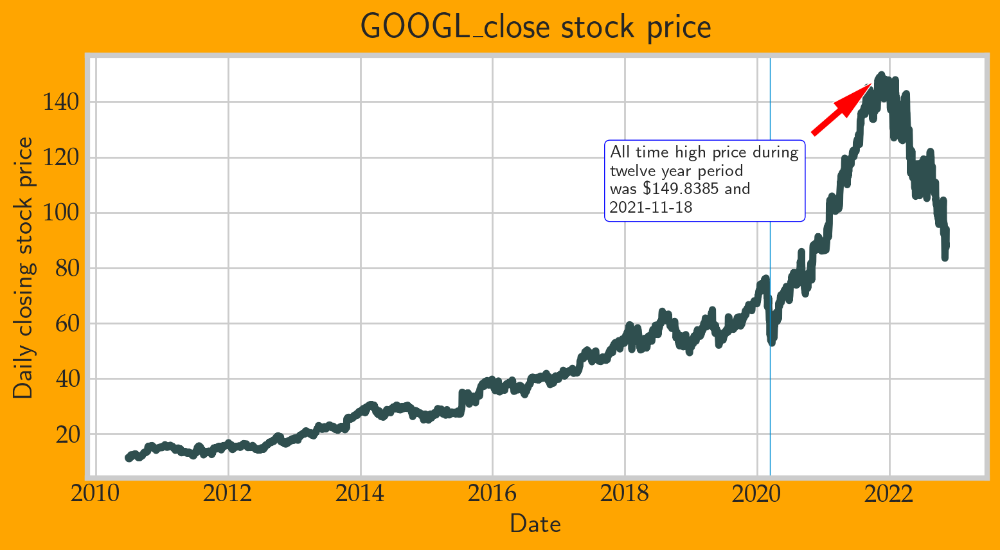

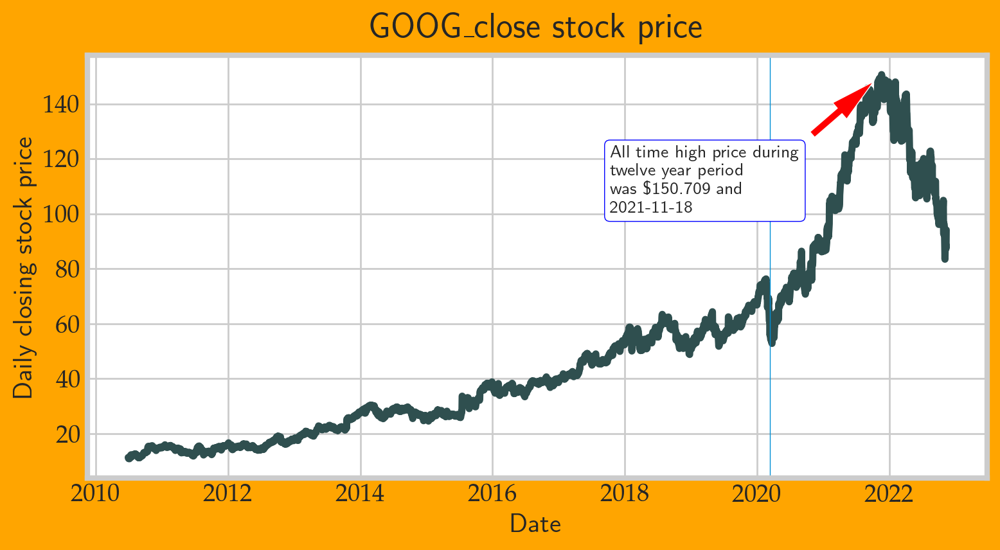

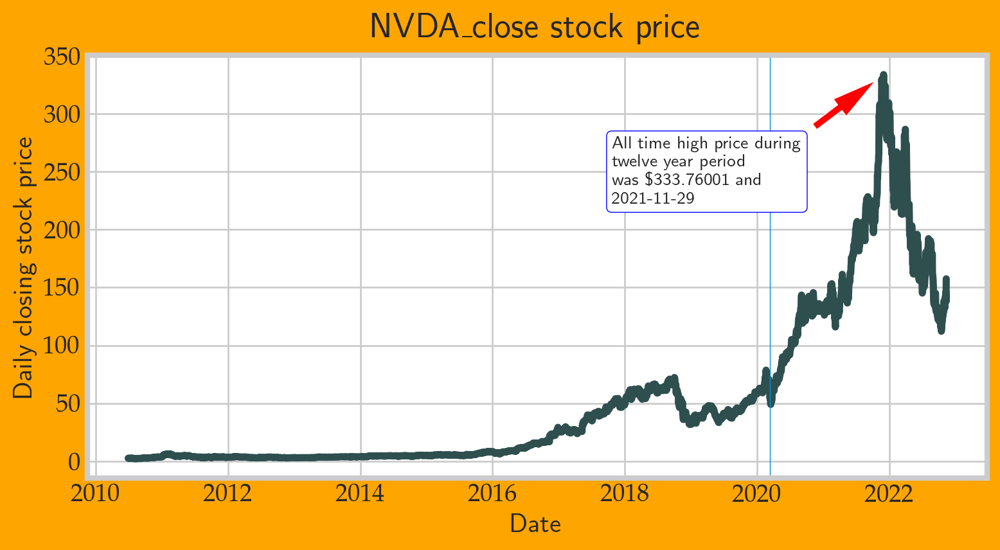

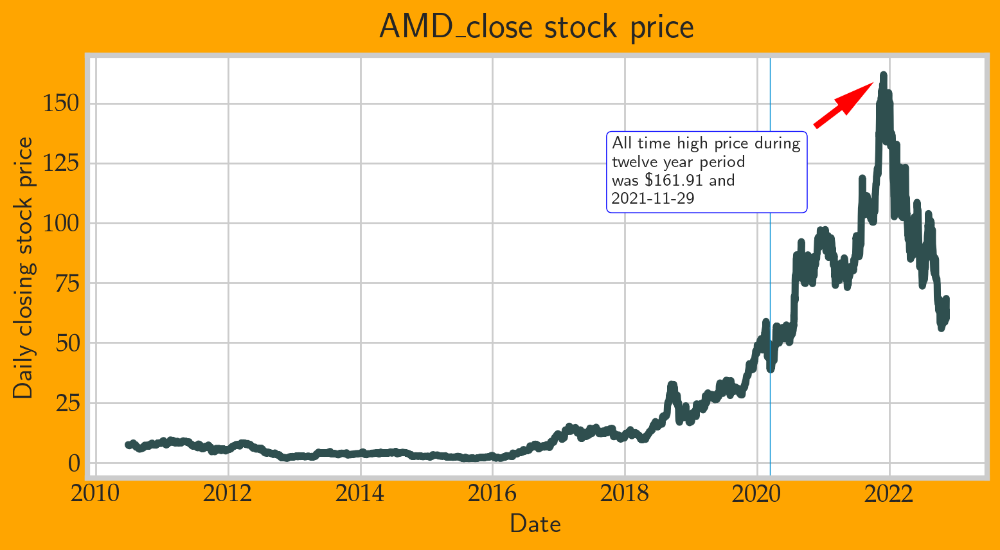

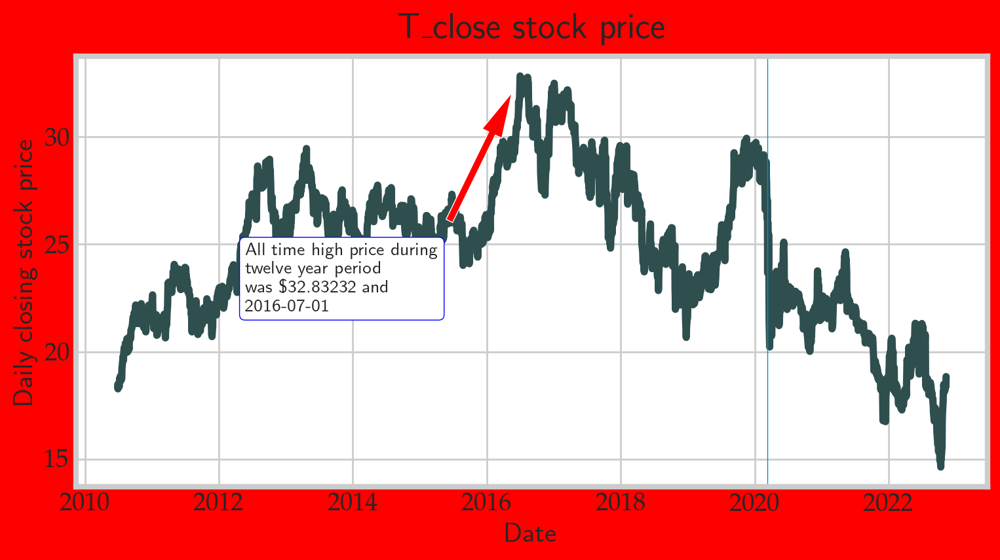

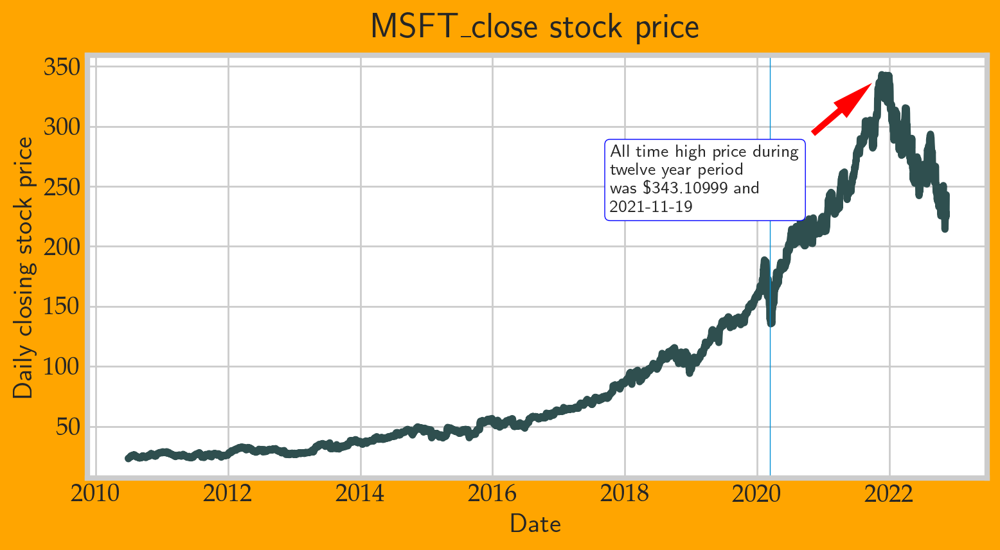

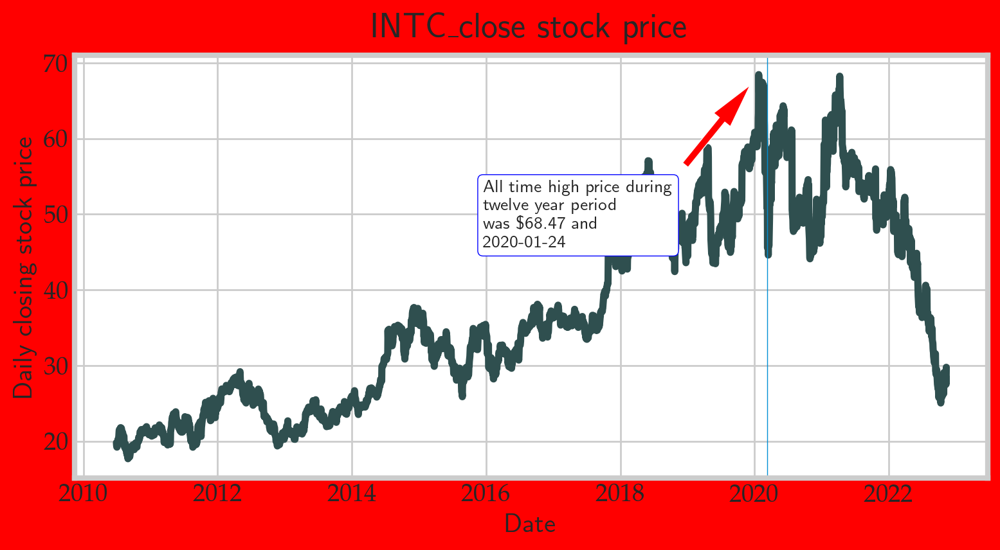

In [20]:
for col in close_columns[1:]:
    closing_stock_price(df_tech[['date', col]], col)

### Observing Moving Average

In [21]:
#####################################################
# Plots moving average
#####################################################
def moving_average_plot(df, value_col='close', moving_avg=False):
    """
    Calls moving_average function
    then plots the moving averages
    """
    
    def moving_average(df, value_col):
        """
        Calculates moving average of inputed column
        Default is 10 days, 50 days, and 200 days.
        """
        df['10_d_avg'] = df[value_col].rolling(window=10).mean()
        df['50_d_avg'] = df[value_col].rolling(window=50).mean()
        df['200_d_avg'] = df[value_col].rolling(window=200).mean()
    
        return df
    
    # running moving_average function and setting date as index column
    df = moving_average(df.copy(), value_col).set_index('date')
    
    if moving_avg:
        return df

    
    # plotting
    from plotly.subplots import make_subplots   
    fig = make_subplots(rows=1, cols=1)
    
    # set colors and cols names to be plotted
    colors = ['#c4c728', '#ed9911', '#eb1005', '#05d4eb']
    avgs = ['10_d_avg','50_d_avg','200_d_avg', value_col]
    
    for column, color in zip(avgs, colors):
        fig.append_trace({'x': df.index,
                          'y': df[column],
                          'type': 'scatter',
                          'name': column,
                          'line': {'color': color}},
                         1, 1)

    fig['layout'].update(height=500,
                         title=f"Relationship between Moving averages and Closing Price of\
                               {value_col}",
                         paper_bgcolor='limegreen', plot_bgcolor='#f2fcfb')
    
    fig.show()

In [22]:
# Interactive plots of MA for top tech stocks
for col in df_tech[da_columns].columns[1:]:
    moving_average_plot(df_tech[['date', col]], value_col=col)

# Top Technology Data Analysis Training and Testing Data

Splitting the data into two sections. First is training which runs from: `2012-05-18 - 2022-07-01`. The testing data runs that last four months before the last recorded data point: `2022-07-05 - 2022-11-10`. Thus attempting to predicted a quarterly return. Our Goal is to attempt to predict Apple's stock price on `2022-11-10` using various methods.

In [23]:
# Training data, all data between 2012-07-18 to 2022-07-01
DATE = '2022-07-01'
train = df_tech[(df_tech['date'] <= DATE)]
display( train[close_columns] )

# Testing Data everything after 2022-07-01 to 2022-11-10 (4 Months)
test = df_tech[df_tech['date'] > DATE]
display( test[close_columns] )

,date,AAPL_close,AMZN_close,TSLA_close,GOOGL_close,GOOG_close,NVDA_close,AMD_close,T_close,MSFT_close,INTC_close
0,2010-06-29,9.148929,5.430500,1.592667,11.367868,11.314092,2.620000,7.480000,18.474319,23.309999,19.790001
1,2010-06-30,8.983214,5.463000,1.588667,11.134885,11.082211,2.552500,7.320000,18.270393,23.010000,19.450001
2,2010-07-01,8.874286,5.548000,1.464000,10.998248,10.946221,2.595000,7.390000,18.383686,23.160000,19.250000
3,2010-07-02,8.819286,5.457000,1.280000,10.924675,10.872995,2.562500,7.170000,18.345921,23.270000,19.200001
4,2010-07-06,8.879643,5.503000,1.074000,10.912663,10.861040,2.535000,7.040000,18.436556,23.820000,19.480000
...,...,...,...,...,...,...,...,...,...,...,...
3019,2022-06-27,141.660004,113.220001,244.919998,115.833504,116.622498,168.690002,86.160004,20.780001,264.890015,38.630001
3020,2022-06-28,137.440002,107.400002,232.663330,112.007500,112.571503,159.820007,80.779999,20.610001,256.480011,37.779999
3021,2022-06-29,139.229996,108.919998,228.490005,111.701500,112.256500,155.419998,77.989998,20.950001,260.260010,37.290001
3022,2022-06-30,136.720001,106.209999,224.473328,108.962997,109.372498,151.589996,76.470001,20.959999,256.829987,37.410000


,date,AAPL_close,AMZN_close,TSLA_close,GOOGL_close,GOOG_close,NVDA_close,AMD_close,T_close,MSFT_close,INTC_close
3024,2022-07-05,141.559998,113.500000,233.066666,113.263000,113.887001,149.639999,75.199997,21.170000,262.850006,36.689999
3025,2022-07-06,142.919998,114.330002,231.733337,114.571999,115.213501,151.300003,75.349998,21.090000,266.209991,36.990002
3026,2022-07-07,146.350006,116.330002,244.543335,118.782997,119.306000,158.580002,79.300003,21.150000,268.399994,38.139999
3027,2022-07-08,147.039993,115.540001,250.763336,119.353500,120.168503,158.380005,79.349998,20.799999,267.660004,37.990002
3028,2022-07-11,144.869995,111.750000,234.343338,115.676498,116.522499,151.520004,76.949997,20.660000,264.510010,37.200001
...,...,...,...,...,...,...,...,...,...,...,...
3111,2022-11-04,138.380005,90.980003,207.470001,86.580002,86.699997,141.559998,62.189999,18.320000,221.389999,28.200001
3112,2022-11-07,138.919998,90.529999,197.080002,88.489998,88.650002,143.009995,63.080002,18.360001,227.869995,28.410000
3113,2022-11-08,139.500000,89.980003,191.300003,88.900002,88.910004,146.020004,63.849998,18.570000,228.869995,28.480000
3114,2022-11-09,134.869995,86.139999,177.589996,87.320000,87.400002,137.759995,59.919998,18.379999,224.509995,27.520000


### Analysis of Closing Price and Percent Change of Top Tech Companies

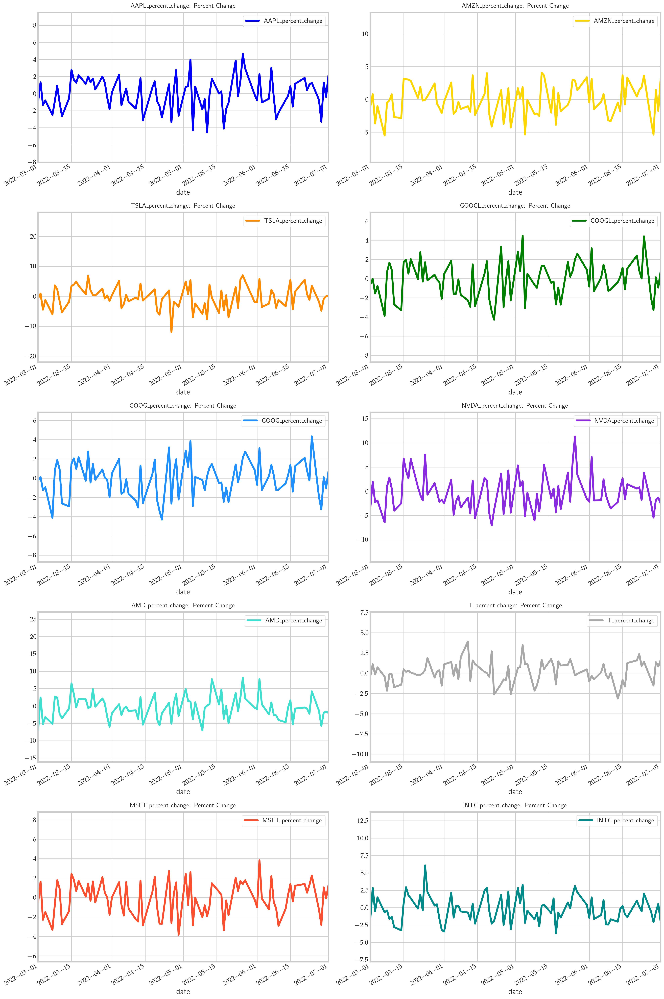

In [24]:
fig, axes = pl.subplots(nrows=5, ncols=2, figsize=(20,30))
loop_columns = df_tech[pc_columns].set_index('date').columns

for col, ax, color in zip(loop_columns, axes.flatten(), COLORS):
    train.set_index('date')[col].plot(legend=True, color=color, ax=ax)
    ax.set_xlim([pd.to_datetime('2022-03-01'), pd.to_datetime('2022-07-01')])
    
    ax.set_title(col + ": Percent Change")
    ax.tick_params(labelsize=14)

## Apple and Mircsoft

In [26]:
display(stock_data_show(train[pc_columns].describe()),
        stock_data_show(train[close_columns].corr()) )

,AAPL_percent_change,AMZN_percent_change,TSLA_percent_change,GOOGL_percent_change,GOOG_percent_change,NVDA_percent_change,AMD_percent_change,T_percent_change,MSFT_percent_change,INTC_percent_change
count,3024.000000,3024.000000,3024.000000,3024.000000,3024.000000,3024.000000,3024.000000,3024.000000,3024.000000,3024.000000
mean,0.029737,0.020243,0.027101,0.004885,0.018995,0.039694,-0.015814,-0.005071,0.047325,0.055935
std,1.371814,1.594562,2.954034,1.242591,1.249870,2.265238,2.899508,1.004169,1.229155,1.359558
min,-7.257864,-8.561455,-19.753523,-8.012820,-8.012814,-13.207547,-14.173224,-10.118606,-5.924653,-6.818866
25%,-0.722282,-0.833340,-1.512159,-0.630719,-0.617337,-1.155706,-1.644026,-0.532601,-0.598668,-0.687499
50%,0.055507,0.000000,-0.012205,0.012420,0.021475,0.011103,-0.153434,0.000000,0.039409,0.062158
75%,0.832073,0.939967,1.567838,0.711113,0.746946,1.215915,1.507264,0.536423,0.745386,0.787878
max,8.696110,12.215611,25.736833,6.192300,6.138794,14.911421,25.078368,6.694563,8.102450,12.784920


,AAPL_close,AMZN_close,TSLA_close,GOOGL_close,GOOG_close,NVDA_close,AMD_close,T_close,MSFT_close,INTC_close
AAPL_close,1.000000,0.938346,0.948129,0.968015,0.969197,0.969567,0.975034,-0.497808,0.985163,0.737025
AMZN_close,0.938346,1.000000,0.823601,0.943306,0.944247,0.901607,0.915013,-0.419655,0.964953,0.870809
TSLA_close,0.948129,0.823601,1.000000,0.907218,0.908939,0.953153,0.947652,-0.559631,0.912674,0.548966
GOOGL_close,0.968015,0.943306,0.907218,1.000000,0.999826,0.962606,0.936667,-0.406312,0.980323,0.793724
GOOG_close,0.969197,0.944247,0.908939,0.999826,1.000000,0.963784,0.938752,-0.412537,0.981524,0.791988
NVDA_close,0.969567,0.901607,0.953153,0.962606,0.963784,1.000000,0.970858,-0.537542,0.963422,0.674161
AMD_close,0.975034,0.915013,0.947652,0.936667,0.938752,0.970858,1.000000,-0.570231,0.972434,0.675135
T_close,-0.497808,-0.419655,-0.559631,-0.406312,-0.412537,-0.537542,-0.570231,1.000000,-0.485004,-0.147288
MSFT_close,0.985163,0.964953,0.912674,0.980323,0.981524,0.963422,0.972434,-0.485004,1.000000,0.797716
INTC_close,0.737025,0.870809,0.548966,0.793724,0.791988,0.674161,0.675135,-0.147288,0.797716,1.000000


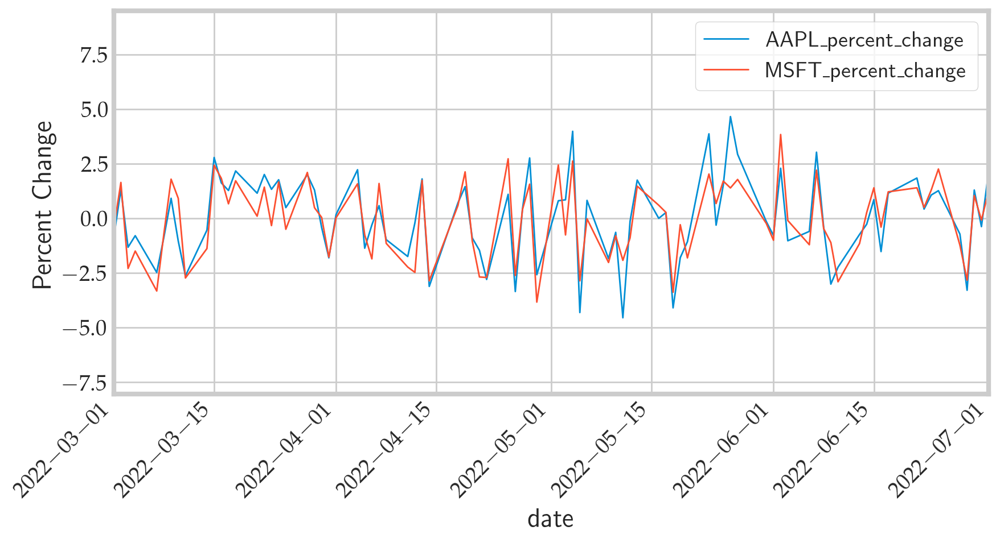

In [27]:
train[['date',
       'AAPL_percent_change',
       'MSFT_percent_change']].set_index('date').plot(legend=True,
                                                      linewidth=1,
                                                      figsize=(9,5))
pl.xlim([pd.to_datetime('2022-03-01'), pd.to_datetime('2022-07-01')])
pl.ylabel('Percent Change')
pl.xticks(rotation=45)
pl.legend()
pl.show()

# <center>  Attempting to Predict Apple Using Other Top Tech

# Linear Model Tests

I do not excepct these to be good models, I want to test the relatioship between modeling Apple's percent change, and closing price and other tech stocks using an OLS model. I seek to understand the multicollinearity, SEE values using this method. I will go as far to remove non-statistically significant variables in the model and no futher. I will then move on and run ML and add lag terms.

Findings: It seems that using this to find closing values is not great, but percent change in Apple's stock gave me a smaller SSE than expected. These models are bad for prdiction due to there dependnce on future varaibles of other stocks. I seek now to use machine learning models with the history of the models that best predicted the percent change where the only dependecy is lag terms and lag terms of other technology company stocks.
    
## Apple's Percent Change OLS Model
Removeing non-significant variables from Apple's percent change equation. <br>
Variables removed:
```
GOOG_percent_change
T_percent_change
INTC_percent_change
```

In [28]:
apple_str_pc = 'AAPL_percent_change ~\
                AMZN_percent_change +\
                TSLA_percent_change +\
                NVDA_percent_change +\
                AMD_percent_change +\
                GOOGL_percent_change +\
                MSFT_percent_change'


apple_model_pc = smf.ols(formula=apple_str_pc, data=train).fit()

display( apple_model_pc.summary() )
display(VIF_calculator(train, apple_str_pc))

<class 'statsmodels.iolib.summary.Summary'>
"""
                             OLS Regression Results                            
===============================================================================
Dep. Variable:     AAPL_percent_change   R-squared:                       0.438
Model:                             OLS   Adj. R-squared:                  0.437
Method:                  Least Squares   F-statistic:                     392.6
Date:                 Mon, 05 Dec 2022   Prob (F-statistic):               0.00
Time:                         13:58:02   Log-Likelihood:                -4373.9
No. Observations:                 3024   AIC:                             8762.
Df Residuals:                     3017   BIC:                             8804.
Df Model:                            6                                         
Covariance Type:             nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
Intercept                0.0102      0.019      0.544      0.587      -0.027       0.047
AMZN_percent_change      0.1129      0.016      7.017      0.000       0.081       0.144
TSLA_percent_change      0.0300      0.007      4.292      0.000       0.016       0.044
NVDA_percent_change      0.0727      0.011      6.424      0.000       0.051       0.095
AMD_percent_change       0.0287      0.008      3.672      0.000       0.013       0.044
GOOGL_percent_change     0.2534      0.022     11.416      0.000       0.210       0.297
MSFT_percent_change      0.2701      0.021     12.717      0.000       0.228       0.312
==============================================================================
Omnibus:                      191.312   Durbin-Watson:                   2.090
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              837.251
Skew:                           0.090   Prob(JB):                    1.56e-182
Kurtosis:                       5.572   Cond. No.                         5.30
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

,VIF,variable
0,1.002682,Intercept
1,1.877668,AMZN_percent_change
2,1.213432,TSLA_percent_change
3,1.878349,NVDA_percent_change
4,1.465555,AMD_percent_change
5,2.171520,GOOGL_percent_change
6,1.946196,MSFT_percent_change


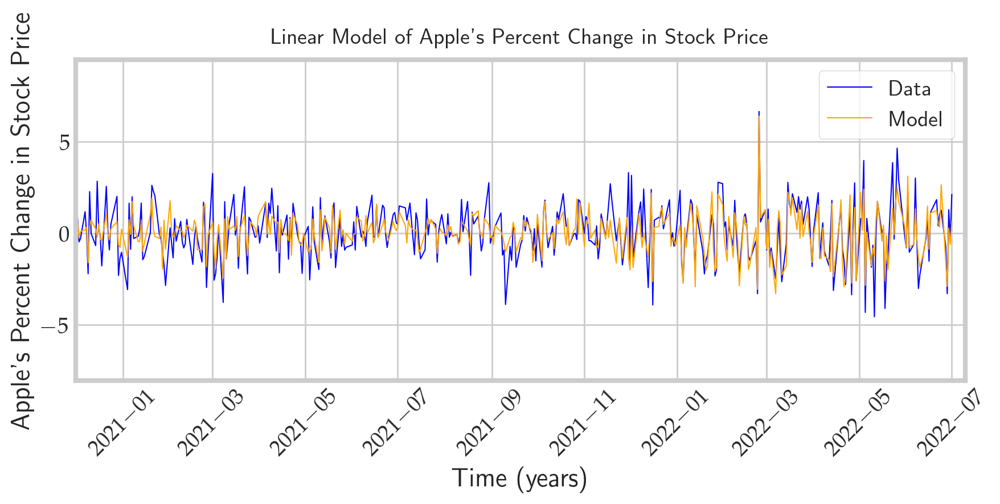

Training:
SSE = 3194.632571501949
MAE = 48.91180623434567
RMSE = 65.78934961092243


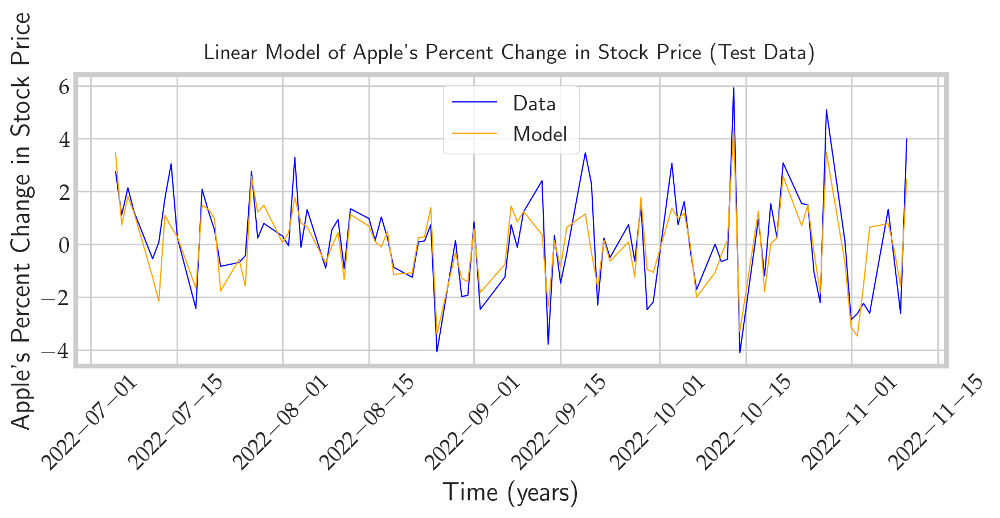

Testing:
SSE = 83.7691203207543
MAE = 0.7196967569680686
RMSE = 0.8483494309351947


In [29]:
###################################################
# Plot data and models Y_hat
###################################################
pl.figure(figsize=(9,4.5))
pl.plot(train.date, train.AAPL_percent_change,
        color=COLORS[0], linewidth=0.75, label='Data')
pl.plot(train.date, apple_model_pc.predict(train),
        color='orange', linewidth=0.75, label='Model')
pl.title("Linear Model of Apple's Percent Change in Stock Price")
pl.xlabel('Time (years)')
pl.ylabel("Apple's Percent Change in Stock Price")
pl.xlim([pd.to_datetime('2020-12-01'), pd.to_datetime('2022-07-10')])
pl.xticks(rotation=45)
pl.legend()
pl.show()

# Error analysis of training data 
print(f'Training:\nSSE = {sum(apple_model_pc.resid**2)}')
print(f'MAE = {mean_absolute_error(train.AAPL_close, apple_model_pc.predict(train))}')
print(f'RMSE = {np.sqrt(mean_squared_error(train.AAPL_close, apple_model_pc.predict(train)))}')


###################################################
# Plotting testing data and Models predicted values
###################################################
pl.figure(figsize=(9,4.5))
pl.plot(test.date, test.AAPL_percent_change,
        color=COLORS[0], linewidth=0.75, label='Data')
pl.plot(test.date, apple_model_pc.predict(test),
        color='orange', linewidth=0.75, label='Model')
pl.title("Linear Model of Apple's Percent Change in Stock Price (Test Data)")
pl.xlabel('Time (years)')
pl.ylabel("Apple's Percent Change in Stock Price")
pl.xticks(rotation=45)
pl.legend()
pl.show()

# Error analysis of testing data 
print(f'Testing:\nSSE = {sum((test.AAPL_percent_change - apple_model_pc.predict(test))**2)}')
print(f'MAE = {mean_absolute_error(test.AAPL_percent_change, apple_model_pc.predict(test))}')
print(f'RMSE = {np.sqrt(mean_absolute_error(test.AAPL_percent_change, apple_model_pc.predict(test)))}')

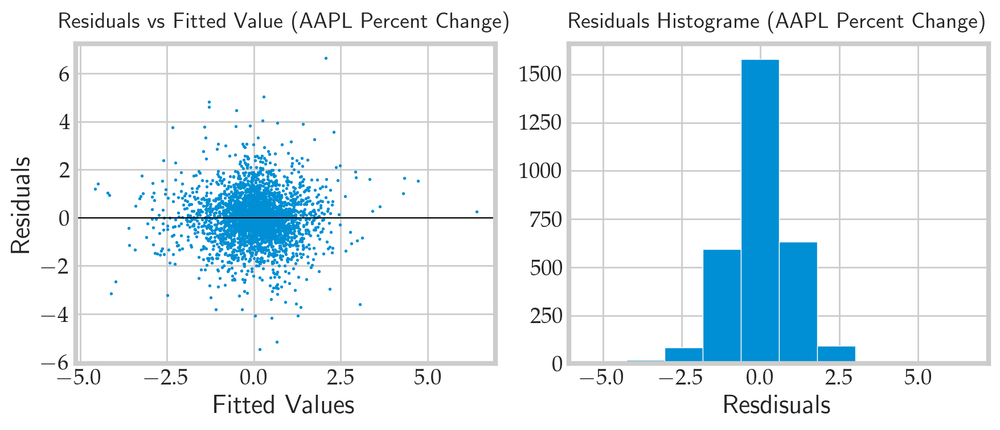

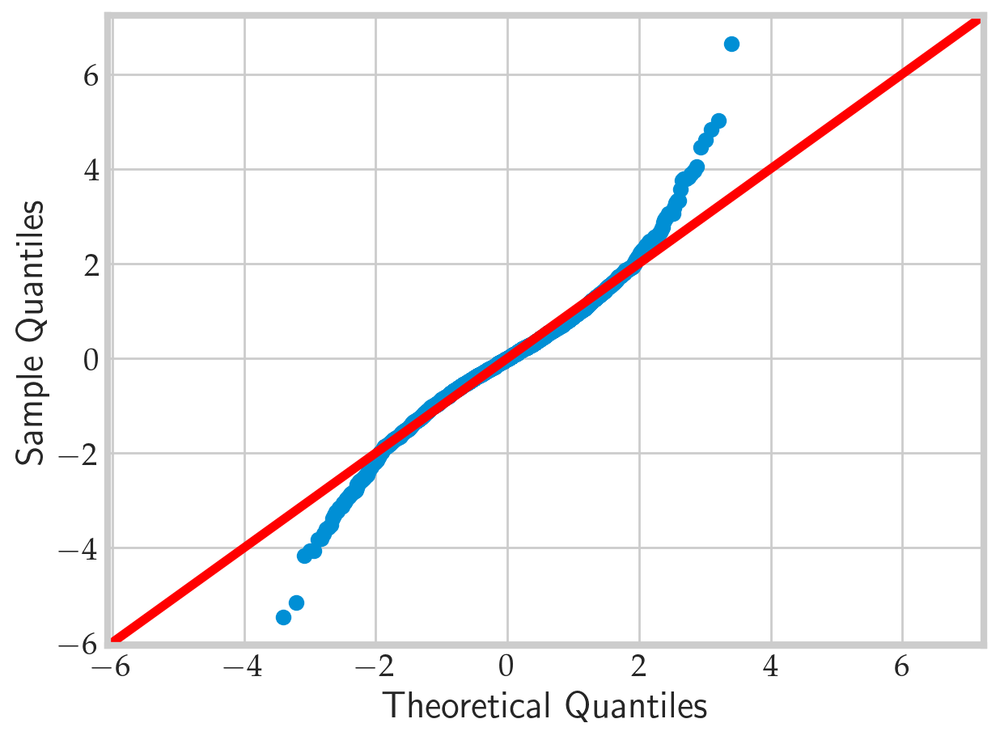

In [30]:
fig, axes = pl.subplots(1, 2, figsize=(9,4))

# Residuals vs Fitted
axes[0].scatter(apple_model_pc.fittedvalues, apple_model_pc.resid, s=2)
axes[0].set_title('Residuals vs Fitted Value (AAPL Percent Change)')
axes[0].axhline(0, color='black', linewidth=0.75)
axes[0].set_xlabel("Fitted Values")
axes[0].set_ylabel("Residuals")

# Histogram of residuals
axes[1].hist(apple_model_pc.resid)
axes[1].set_title('Residuals Histograme (AAPL Percent Change)')
axes[1].set_xlabel("Resdisuals")

sm.qqplot(apple_model_pc.resid, line='45'); pl.show()

## Apple's Closing Price OLS Model
Removeing non-significant variables from Apple's close equation. <br>

This is not a good model, returns higher SSE when remvoving variables with high VIF values. Lag terms help SSE however not good for long term forecasting.

In [31]:
# 30 day lag terms

def N_lag(df_col, n: int):
    
    df_col = pd.DataFrame(df_col).copy()
    for i in range(n):
        df_col = df_col.loc[:, ].shift()
            
    return df_col

# Try adding month lag test
# df_tech['AAPL_close_30_LAG'] = N_lag(df_tech['AAPL_close'], n=30)
# df_tech['MSFT_close_30_LAG'] = N_lag(df_tech['MSFT_close'], n=30)
# df_tech['GOOGL_close_30_LAG'] = N_lag(df_tech['GOOGL_close'], n=30)
# df_tech['AMD_close_30_LAG'] = N_lag(df_tech['AMD_close'], n=30)
# df_tech['NVDA_close_30_LAG'] = N_lag(df_tech['NVDA_close'], n=30)

# Shift of apples PC and Close, Previous day's value
df_tech[['AAPL_close_LAG']] = df_tech.loc[:,['AAPL_close']].shift()
df_tech[['MSFT_close_LAG']] = df_tech.loc[:,['MSFT_close']].shift()

#df_tech.dropna(inplace=True)
df_tech.dropna(inplace=True)
train = df_tech[df_tech.date <= DATE]
test = df_tech[df_tech.date > DATE]

In [32]:
# Various tests to use simply OLS to predict Apple's stock
apple_model_close = 'AAPL_close ~\
                     AAPL_close_LAG +\
                     MSFT_close_LAG'

# apple_model_close = 'AAPL_close ~\
#                      MSFT_close +\
#                      AMZN_close +\
#                      GOOGL_close +\
#                      GOOG_close +\
#                      NVDA_close +\
#                      AMD_close +\
#                      T_close +\
#                      INTC_close'

# apple_model_close = 'AAPL_close ~\
#                      AAPL_close_30_LAG +\
#                      MSFT_close_30_LAG +\
#                      GOOGL_close_30_LAG +\
#                      AMD_close_30_LAG +\
#                      NVDA_close_30_LAG'

apple_lm_close = smf.ols(formula=apple_model_close, data=train).fit()

# Error analysis of testing data 
display(apple_lm_close.summary())
display(VIF_calculator(train, apple_model_close))

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             AAPL_close   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 1.744e+06
Date:                Mon, 05 Dec 2022   Prob (F-statistic):               0.00
Time:                        13:59:19   Log-Likelihood:                -5067.5
No. Observations:                3023   AIC:                         1.014e+04
Df Residuals:                    3020   BIC:                         1.016e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept          0.0113      0.036      0.317      0.751      -0.059       0.081
AAPL_close_LAG     0.9859      0.003    316.173      0.000       0.980       0.992
MSFT_close_LAG     0.0075      0.002      4.630      0.000       0.004       0.011
==============================================================================
Omnibus:                      639.341   Durbin-Watson:                   2.125
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            22736.850
Skew:                          -0.152   Prob(JB):                         0.00
Kurtosis:                      16.432   Cond. No.                         219.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

,VIF,variable
0,2.293491,Intercept
1,33.913592,AAPL_close_LAG
2,33.913592,MSFT_close_LAG


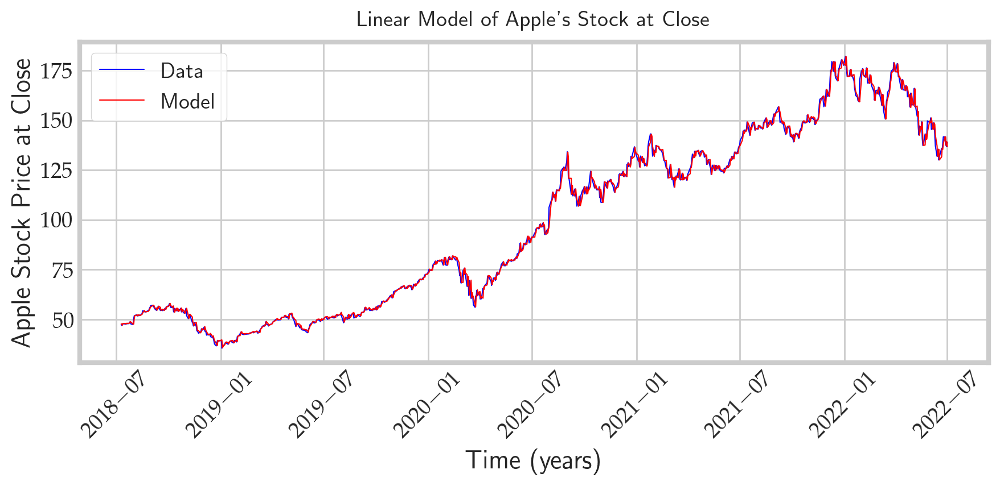

Training:
SSE = 5058.159103950737
MAE = 0.6672676678725824
RMSE = 1.2935319773770964


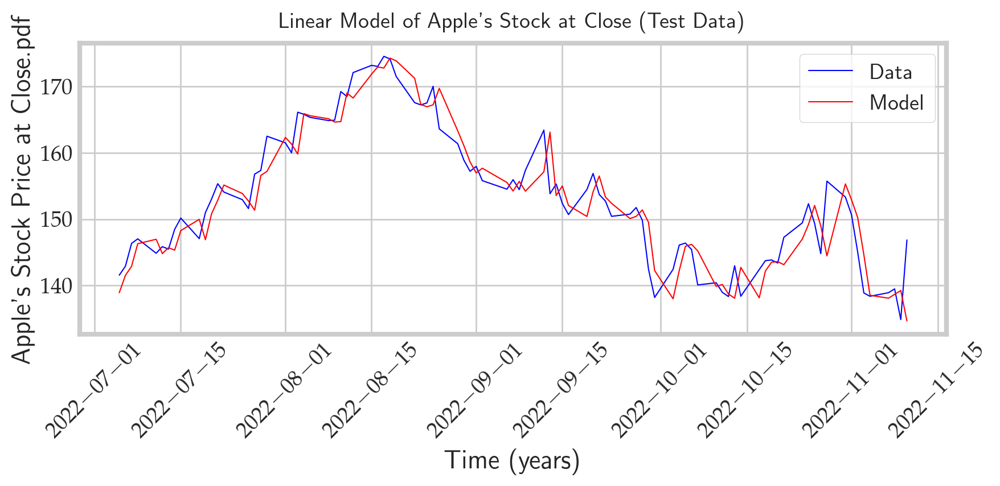

Testing:
SSE = 1112.4412689489252
MAE = 2.583926505444122
RMSE = 1.6074596434884834


In [33]:
###################################################
# Training data with Y_hat plot
###################################################
pl.figure(figsize=(9,4.5))
pl.plot(train.date.loc['2020-05-05':], train.AAPL_close.loc['2020-05-05':],
        color=COLORS[0], linewidth=0.75, label='Data')
pl.plot(train.date.loc['2020-05-05':], apple_lm_close.predict(train.loc['2020-05-05':]),
        color='red', linewidth=0.75, label='Model')
pl.title("Linear Model of Apple's Stock at Close")
pl.xlabel('Time (years)')
pl.ylabel('Apple Stock Price at Close')
pl.xticks(rotation=45)
pl.legend()
pl.show()

# Error analysis
print(f'Training:\nSSE = {sum(apple_lm_close.resid**2)}')
print(f'MAE = {mean_absolute_error(train.AAPL_close, apple_lm_close.predict(train))}')
print(f'RMSE = {np.sqrt(mean_squared_error(train.AAPL_close, apple_lm_close.predict(train)))}')


###################################################
# Plotting testing data and Models predicted values
###################################################
pl.figure(figsize=(9,4.5))
pl.plot(test.date, test.AAPL_close,
        color=COLORS[0], linewidth=0.75, label='Data')
pl.plot(test.date, apple_lm_close.predict(test),
        color='red', linewidth=0.75, label='Model')
pl.title("Linear Model of Apple's Stock at Close (Test Data)")
pl.xlabel('Time (years)')
pl.ylabel("Apple's Stock Price at Close.pdf")
pl.xticks(rotation=45)
pl.legend()
pl.show()

# Error analysis of testing data 
print(f'Testing:\nSSE = {sum((test.AAPL_close - apple_lm_close.predict(test))**2)}')
print(f'MAE = {mean_absolute_error(test.AAPL_close, apple_lm_close.predict(test))}')
print(f'RMSE = {np.sqrt(mean_absolute_error(test.AAPL_close, apple_lm_close.predict(test)))}')

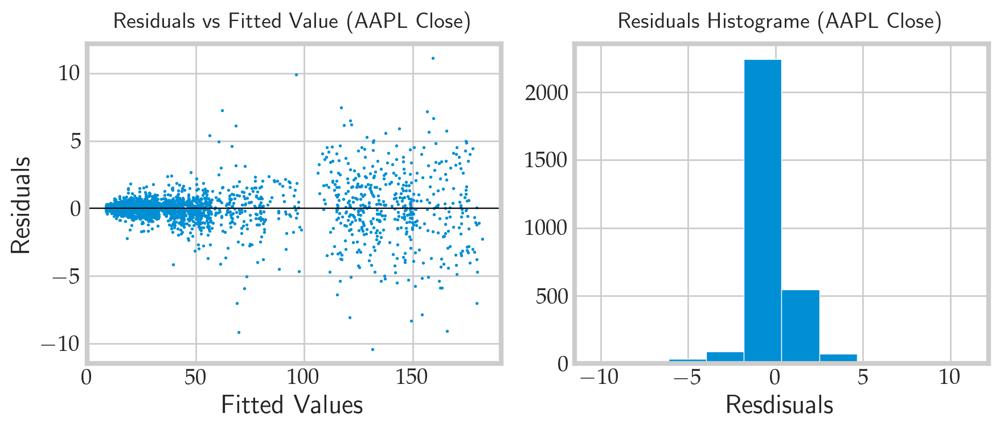

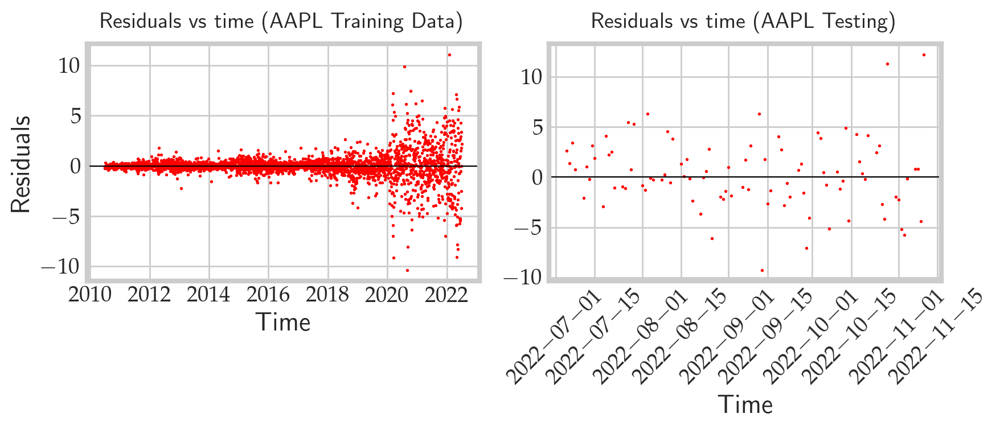

In [34]:
fig, axes = pl.subplots(1, 2, figsize=(9,4))

# Residuals vs Fitted
axes[0].scatter(apple_lm_close.fittedvalues, apple_lm_close.resid, s=2)
axes[0].set_title('Residuals vs Fitted Value (AAPL Close)')
axes[0].axhline(0, color='black', linewidth=0.75)
axes[0].set_xlabel("Fitted Values")
axes[0].set_ylabel("Residuals")

# Histogram of residuals
axes[1].hist(apple_lm_close.resid)
axes[1].set_title('Residuals Histograme (AAPL Close)')
axes[1].set_xlabel("Resdisuals")
pl.show()


# Observe how cone shapre is related to time
fig, axes = pl.subplots(1, 2, figsize=(9,4))
axes[0].scatter(train.date, apple_lm_close.resid, s=2, color='red')
axes[0].set_title('Residuals vs time (AAPL Training Data)')
axes[0].axhline(0, color='black', linewidth=0.75)
axes[0].set_xlabel("Time")
axes[0].set_ylabel("Residuals")

axes[1].scatter(test.date, test.AAPL_close - apple_lm_close.predict(test), s=2, color='red')
axes[1].set_title('Residuals vs time (AAPL Testing)')
axes[1].axhline(0, color='black', linewidth=0.75)
pl.xticks(rotation=45)
axes[1].set_xlabel("Time")
pl.show()

# <center> Machine Learning Models

# Auto - ARIMA Model

ARIMA Model Equation/Formula
Three factors define ARIMA model, it is defined as ARIMA( $p, d, q)$ where $p, d$, and $q$ denote the number of lagged (or past) observations to consider for autoregression, the number of times the raw observations are differenced, and the size of the moving average window respectively.
The below equation shows a typical autoregressive model. As the name suggests, the new values of this model depend purely on a weighted linear combination of its past values. Given that there are $p$ past values, this is denoted as $A R(p)$ or an autoregressive model of the order $p$. Epsilon $(\varepsilon)$ indicates the white noise
$$
Y_t=\alpha+\beta_1 Y_{t-1}+\beta_2 Y_{t-2}+\ldots+\beta_p Y_{t-p}+\epsilon_1
$$
Next, the moving average is defined as follows:
$$
y_t=c+\varepsilon_t+\theta_1 \varepsilon_{t-1}+\theta_2 \varepsilon_{t-2}+\cdots+\theta_q \varepsilon_{t-q},
$$
Here, the future value $y(t)$ is computed based on the errors $\varepsilon$ made by the previous model. So, each successive term looks one step further into the past to incorporate the mistakes made by that model in the current computation. Based on the window we are willing to look past, the value of $q$ is set. Thus, the above model can be independently denoted as a moving average order $q$ or simply MA(q).


<br>
An autoregressive integrated moving average, or ARIMA, is a statistical analysis model that uses time series data to either better understand the data set or to predict future trends. 

A statistical model is autoregressive if it predicts future values based on past values. For example, an ARIMA model might seek to predict a stock's future prices based on its past performance or forecast a company's earnings based on past periods.


- Autoregression (AR): refers to a model that shows a changing variable that regresses on its own lagged, or prior, values.
- Integrated (I): represents the differencing of raw observations to allow for the time series to become stationary (i.e., data values are replaced by the difference between the data values and the previous values).
- Moving average (MA):  incorporates the dependency between an observation and a residual error from a moving average model applied to lagged observations. <br> 

## Text copied from cite: [investopedia](https://www.investopedia.com/terms/a/autoregressive-integrated-moving-average-arima.asp)

Fidning best `d` value for our model: Since our P value is small for 1st order d=1. For our `p` we see that for first order the pacf function has a noticiable difference for the first and second data point, so p=1.  “q” can be estimated similarly by looking at the ACF plot instead of the PACF plot. Looking at the number of lags crossing the threshold, we can determine how much of the past would be significant enough to consider for the future. Here we see we need a large value for q 

Cite [[1]](https://www.projectpro.io/article/how-to-build-arima-model-in-python/544)

## Analysis Before Arima Modeling

In [40]:
#####################################################
# Finding seasonl decomposition of time-series models
#####################################################
def seasonl_decomposition_plot(df, perdict_period: int, varialbe_col='x', forcast_col='y'):
    """
    Plots and finds seasonal trends
    """
    from statsmodels.tsa.seasonal import seasonal_decompose
    
    # create function to return dataframe for forecating
    def dataframe_formatting(df):
        
        df = df.loc[:, [varialbe_col, forcast_col]]
        df.rename(columns={varialbe_col: 'dt'}, inplace=True)

        return df
    
    df = dataframe_formatting(df)
    
    # decompistion instance
    result_decom = seasonal_decompose(df[forcast_col],
                                      model="additive", 
                                      period=perdict_period,
                                      extrapolate_trend='freq')
    # plot the componenets 
    fig = result_decom.plot()
    fig.set_size_inches((9.5, 6))
    # Tight layout to realign things
    fig.tight_layout()
    pl.show()

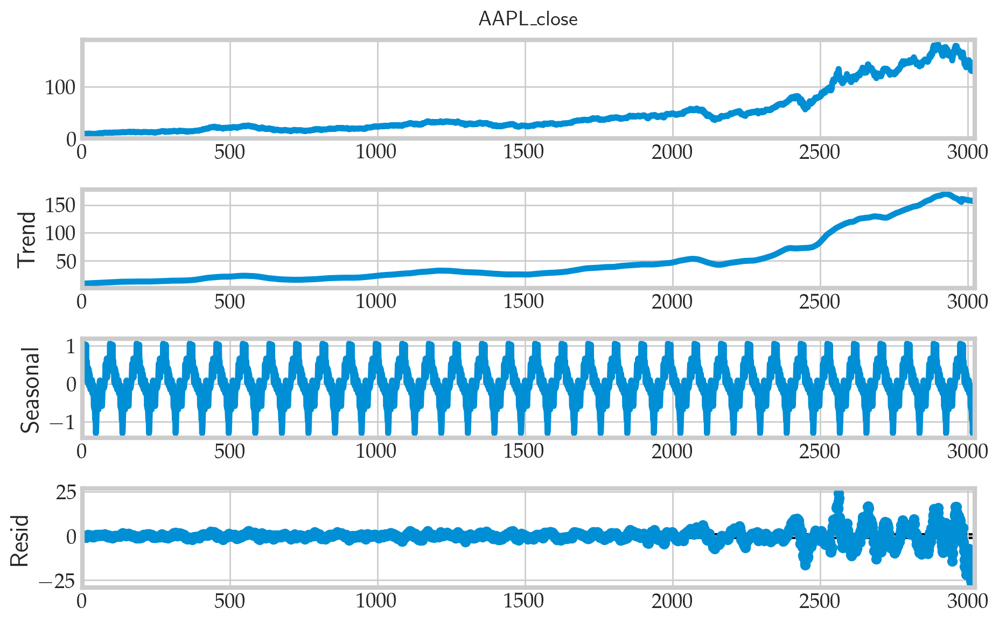

In [16]:
seasonl_decomposition_plot(train, perdict_period=90, varialbe_col='date', forcast_col='AAPL_close')

## Building AUTO - ARIMA For Appl's Close Price

In [41]:
def ARIMA_best(model, whole_data, train, test, get_best_model=False, display_best_model=False,
               plot_model=True, stats=True, index=0, dim=(8,4.5)):
    
    assert test.index[0] > index, f'Make sure that the test data index is less than index: {index}'
    
    from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
    from statsmodels.tsa.arima.model import ARIMA
    
    # Forcasting manual model
    n = len(test)
    forecast_test = model.forecast(n)
    whole_data = pd.DataFrame(whole_data)
    whole_data['forecast_manual'] = [None]*len(train) + list(forecast_test)
    
    # Plotting Manual Modal
    if plot_model and not get_best_model:
        
        # Getting model values
        train_pred = model.fittedvalues
    
        prediction = model.get_forecast(n)
        conf_int = prediction.conf_int()
        lower, upper = conf_int[conf_int.columns[0]], conf_int[conf_int.columns[1]]

        # Plotting
        whole_data[index:].plot(linewidth=1.5, figsize=dim)
        pl.plot(train[index:].index, train_pred[index:],
                color='green', label='fitted', linewidth=1.25)
        pl.fill_between(test.index, lower, upper, color='red', alpha=0.25)
        pl.legend()

        
    # forming best model and plotting
    elif get_best_model:
        
        d_val = int(input('Please input a value for d: '))
        
        from warnings import filterwarnings
        filterwarnings("ignore")
        
        from pmdarima import auto_arima
        AA_model = auto_arima(train,
                              d=d_val,
                              start_p=0,
                              max_p=10,
                              start_q=0,
                              max_q=10,
                              max_order=30,
                              stepwise=False,
                              seasonal=True)
        
        forecast_test_auto = AA_model.predict(n_periods=n)
            
        params = AA_model.get_params()
        d = params['order'][1]
        
        #In sample data prediction
        train_pred = AA_model.predict_in_sample(start=d, end=-1)
        
        #out of sample prediction
        test_pred, conf = AA_model.predict(n_periods=n, return_conf_int=True)
        
        # Plotting
        whole_data['forecast_auto'] = [None]*len(train) + list(forecast_test_auto)
        whole_data[index:].plot(linewidth=1.5, figsize=dim)
        pl.plot(train[index:].index[d:], train_pred[index:], 
                color='green', label='Fitted Values', linewidth=1.25)
        pl.plot(test.index, test_pred, label='Forecast Values', linewidth=1.25)
        pl.fill_between(test.index, conf[:,0], conf[:,1], color='red', alpha=0.25)
        pl.legend()

        if display_best_model:
            print(AA_model)
            print(AA_model.summary())

    
    if stats:
        # Manual Model
        MAE = mean_absolute_error(test, forecast_test)
        MAPE = mean_absolute_percentage_error(test, forecast_test)
        RMSE = np.sqrt(mean_squared_error(test, forecast_test))
        SSE = sum( (forecast_test - test)**2 )

        print(f'MAE - manual: {round(MAE, 2)}')
        print(f'MAPE - manual: {round(MAPE*100, 2)}%')
        print(f'RMSE - manual: {round(RMSE, 2)}')
        print(f'SSE - manual: {round(SSE, 2)}\n')
        
        if get_best_model:
            mae = mean_absolute_error(test, forecast_test_auto)
            mape = mean_absolute_percentage_error(test, forecast_test_auto)
            rmse = np.sqrt(mean_squared_error(test, forecast_test_auto))
            sse = sum( (forecast_test - test)**2 )

            print(f'MAE - auto: {round(mae, 2)}')
            print(f'MAPE - auto: {round(mape*100, 2)}%')
            print(f'RMSE - auto: {round(rmse, 2)}')
            print(f'SSE - manual: {round(sse, 2)}')
        
    if get_best_model:
        return AA_model
    

In [42]:
def amira_residual_plots(model):
    
    residuals = model.resid[1:]
    fig, ax = pl.subplots(1,2, figsize=(9,2.5))
    residuals.plot(title='Residuals', ax=ax[0], linewidth=0.9)
    residuals.plot(title='Density', kind='kde', ax=ax[1], linewidth=1.5)

    fig, ax = pl.subplots(1, ncols=2, figsize=(9,2.5))
    from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
    plot_acf(residuals, ax=ax[0])
    plot_pacf(residuals, ax[1], method='ywm')

In [43]:
#####################################################
# Data Analysis plots to help with ARIMA
#####################################################
def find_best_dpq(data, dif=1, stats=True, plot=False, dim=(12,4)):
    
    from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
    
    if dif == 1:
        data_diff = data.diff()
        title = '1st Order Differencing'
        
    elif dif == 2:
        data_diff = data.diff().diff()
        title = '2nd Order Differencing'
        
    elif dif == 0:
        from pmdarima.arima.utils import ndiffs
        d_val = ndiffs(data, test='adf')
        print('Arima D-value:', d_val)
        
        data_diff = data
        title = 'Data'
    
    if plot:
        fig, ax = pl.subplots(1, ncols=3, figsize=dim)

        ax[0].set_title(title)
        ax[0].plot(data_diff)

        plot_acf(data_diff.dropna(), ax=ax[1])
        plot_pacf(data_diff.dropna(), method='ywm', ax=ax[2])

    if stats:
        from statsmodels.tsa.stattools import adfuller
        ad_test0 = adfuller(data.dropna())
        print(f'p-value: {ad_test0[1]}')

        # First Order differencing
        ad_test1 = adfuller(data.diff().dropna())
        print(f'1st Order p-value: {ad_test1[1]}')

        # Second Order differencing
        ad_test2 = adfuller(data.diff().diff().dropna())
        print(f'2nd Order p-value: {ad_test2[1]}')
        
        
def plot_qp(data, lags=20, dim=(8,4.5)):
    
    from pandas.plotting import autocorrelation_plot
    from matplotlib import pyplot
    from statsmodels.graphics.tsaplots import plot_pacf
    
    fig, ax = pl.subplots(nrows=1, ncols=2, figsize=dim)
    
    autocorrelation_plot(data, ax=ax[0])
    plot_pacf(data, lags=lags, ax=ax[1])

Arima D-value: 1
p-value: 0.9810874217936085
1st Order p-value: 1.0919251132736223e-18
2nd Order p-value: 2.3301797787141964e-30


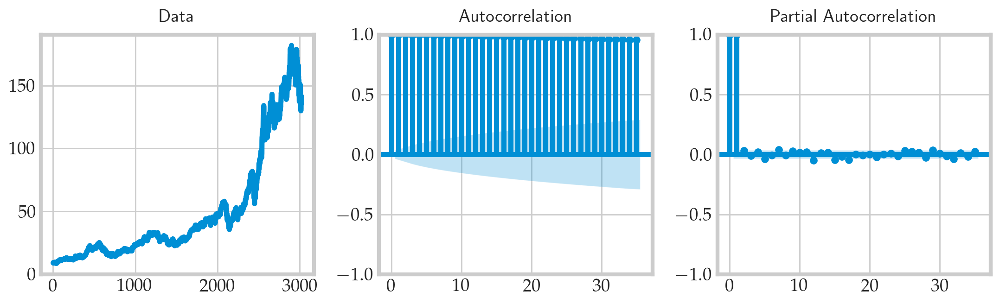

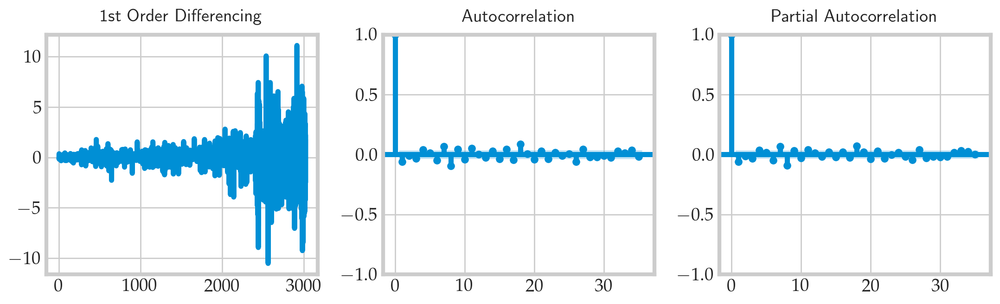

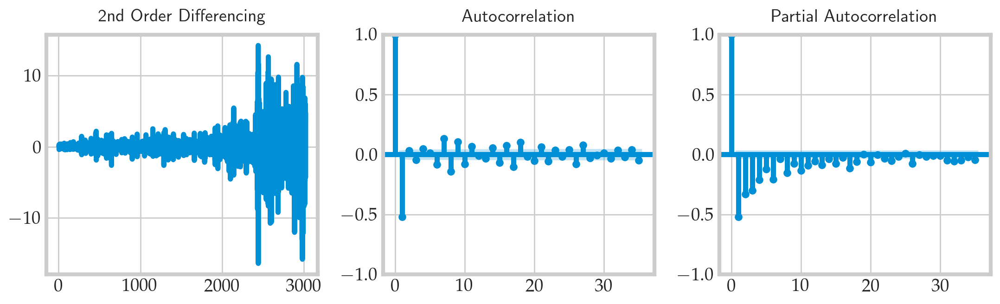

In [44]:
find_best_dpq(train[['AAPL_close']], dif=0, stats=False ,plot=True, dim=(11,3.5))
find_best_dpq(train[['AAPL_close']], stats=False, plot=True, dim=(11,3.5))
find_best_dpq(train[['AAPL_close']], dif=2, plot=True, dim=(11,3.5))

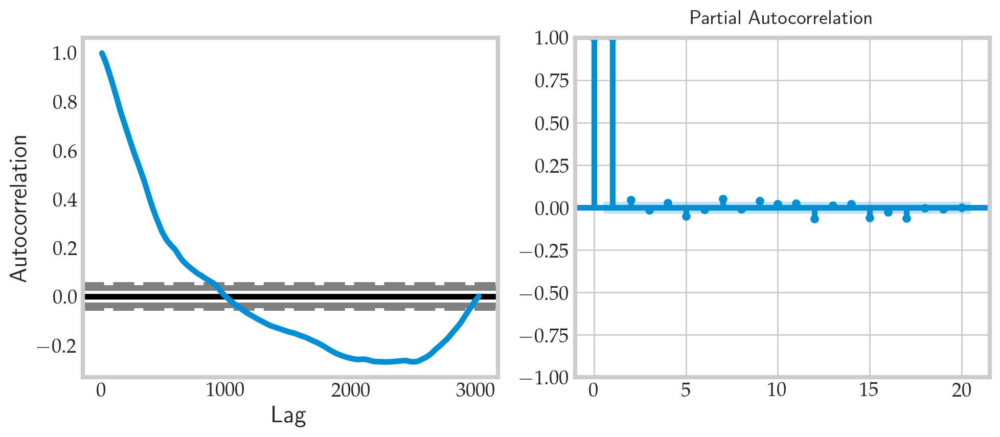

In [45]:
plot_qp(train['AAPL_close'], lags=20, dim=(10,4.5))
# p around 900, q around 2

### My ARIMA Model

In [49]:
from statsmodels.tsa.arima.model import ARIMA

# (2,1,90)
# MAE - manual: 10.53
# MAPE - manual: 6.6%
# RMSE - manual: 13.38
# SSE - manual: 16464.26

#(6,1,4)
# MAE - manual: 13.17
# MAPE - manual: 8.25%
# RMSE - manual: 16.27
# SSE - manual: 24358.63
    
apple_arima = ARIMA(train[['AAPL_close']],
                    order=(6,1,10),
                    trend='t',
                    trend_offset=0)

apple_model_fit = apple_arima.fit()
display(apple_model_fit.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:             AAPL_close   No. Observations:                 3023
Model:                ARIMA(6, 1, 10)   Log Likelihood               -5019.648
Date:                Tue, 29 Nov 2022   AIC                          10075.297
Time:                        17:06:45   BIC                          10183.543
Sample:                             0   HQIC                         10114.218
                               - 3023                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0431      0.023      1.882      0.060      -0.002       0.088
ar.L1          0.1424      0.063      2.273      0.023       0.020       0.265
ar.L2          0.1225      0.053      2.331      0.020       0.019       0.226
ar.L3         -1.2001      0.046    -26.336      0.000      -1.289      -1.111
ar.L4         -0.0716      0.049     -1.453      0.146      -0.168       0.025
ar.L5          0.3166      0.050      6.301      0.000       0.218       0.415
ar.L6         -0.7883      0.052    -15.104      0.000      -0.891      -0.686
ma.L1         -0.1756      0.064     -2.763      0.006      -0.300      -0.051
ma.L2         -0.1490      0.053     -2.832      0.005      -0.252      -0.046
ma.L3          1.1896      0.046     25.908      0.000       1.100       1.280
ma.L4          0.0850      0.049      1.729      0.084      -0.011       0.181
ma.L5         -0.3730      0.053     -7.037      0.000      -0.477      -0.269
ma.L6          0.7470      0.054     13.718      0.000       0.640       0.854
ma.L7          0.0650      0.013      4.902      0.000       0.039       0.091
ma.L8         -0.0439      0.009     -4.743      0.000      -0.062      -0.026
ma.L9         -0.0694      0.009     -7.728      0.000      -0.087      -0.052
ma.L10         0.0669      0.011      6.076      0.000       0.045       0.088
sigma2         1.6190      0.016     99.687      0.000       1.587       1.651
===================================================================================
Ljung-Box (L1) (Q):                   0.02   Jarque-Bera (JB):             20649.17
Prob(Q):                              0.88   Prob(JB):                         0.00
Heteroskedasticity (H):              52.91   Skew:                            -0.11
Prob(H) (two-sided):                  0.00   Kurtosis:                        15.80
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

MAE - manual: 12.97
MAPE - manual: 8.12%
RMSE - manual: 16.08
SSE - manual: nan



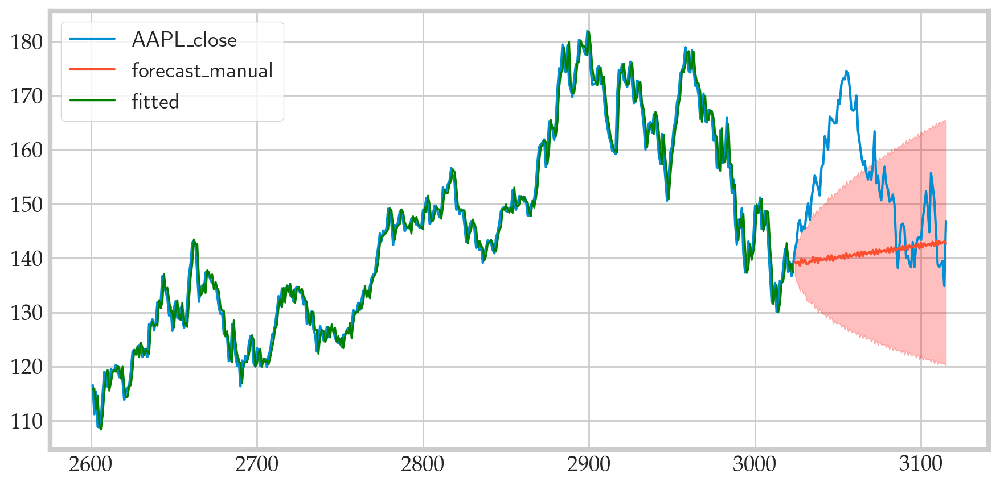

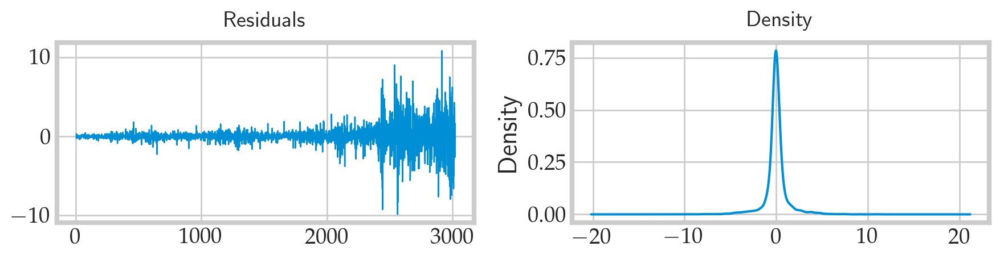

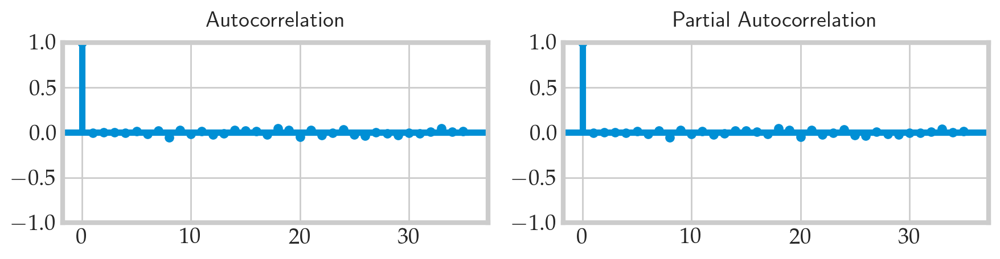

In [50]:
# Plotting Model
ARIMA_best(model=apple_model_fit,
           whole_data=df_tech[['AAPL_close']],
           train=train['AAPL_close'],
           test=test['AAPL_close'],
           get_best_model=False,
           display_best_model=False,
           index=2600,
           dim=(9,4.5))

# Error analysis
amira_residual_plots(apple_model_fit)

# VAR Model

First, what is Vector Autoregression (VAR) and when to use it?

Vector Autoregression (VAR) is a multivariate forecasting algorithm that is used when two or more time series influence each other.

That means, the basic requirements in order to use VAR are:

You need at least two time series (variables)
The time series should influence each other.

<br>
In the VAR model, each variable is modeled as a linear combination of past values of itself and the past values of other variables in the system. Since you have multiple time series that influence each other, it is modeled as a system of equations with one equation per variable (time series).

That is, if you have 5 time series that influence each other, we will have a system of 5 equations.

Well, how is the equation exactly framed?

Let’s suppose, you have two variables (Time series) Y1 and Y2, and you need to forecast the values of these variables at time (t).

To calculate Y1(t), VAR will use the past values of both Y1 as well as Y2. Likewise, to compute Y2(t), the past values of both Y1 and Y2 be used.

For example, the system of equations for a VAR(1) model with two time series (variables `Y1` and `Y2`) is as follows:

$$
\begin{aligned}
&Y_{1, t}=\alpha_1+\beta_{11,1} Y_{1, t-1}+\beta_{12,1} Y_{2, t-1}+\epsilon_{1, t} \\
&Y_{2, t}=\alpha_2+\beta_{21,1} Y_{1, t-1}+\beta_{22,1} Y_{2, t-1}+\epsilon_{2, t}
\end{aligned}
$$

Where, Y{1,t-1} and Y{2,t-1} are the first lag of time series Y1 and Y2 respectively.

The above equation is referred to as a VAR(1) model, because, each equation is of order 1, that is, it contains up to one lag of each of the predictors (Y1 and Y2).

Since the Y terms in the equations are interrelated, the Y’s are considered as endogenous variables, rather than as exogenous predictors.

Likewise, the second order VAR(2) model for two variables would include up to two lags for each variable (Y1 and Y2).

$$
\begin{aligned}
&Y_{1, t}=\alpha_1+\beta_{11,1} Y_{1, t-1}+\beta_{12,1} Y_{2, t-1}+\beta_{11,2} Y_{1, t-2}+\beta_{12,2} Y_{2, t-2}+\epsilon_{1, t} \\
&Y_{2, t}=\alpha_2+\beta_{21,1} Y_{1, t-1}+\beta_{22,1} Y_{2, t-1}+\beta_{21,2} Y_{1, t-2}+\beta_{22,2} Y_{2, t-2}+\epsilon_{2, t}
\end{aligned}
$$

Can you imagine what a second order $\mathrm{VAR}(2)$ model with three variables $(\mathrm{Y} 1$, $\mathrm{Y} 2$ and $\mathrm{Y} 3)$ would look like?

$$
\begin{aligned}
&Y_{1, t}=\alpha_1+\beta_{11,1} Y_{1, t-1}+\beta_{12,1} Y_{2, t-1}+\beta_{13,1} Y_{3, t-1}+\beta_{11,2} Y_{1, t-2}+\beta_{12,2} Y_{2, t-2}+\beta_{13,2} Y_{3, t-2}+\epsilon_{1, t} \\
&Y_{2, t}=\alpha_2+\beta_{21,1} Y_{1, t-1}+\beta_{22,1} Y_{2, t-1}+\beta_{23,1} Y_{3, t-1}+\beta_{21,2} Y_{1, t-2}+\beta_{22,2} Y_{2, t-2}+\beta_{23,2} Y_{3, t-2}+\epsilon_{2, t} \\
&Y_{3, t}=\alpha_3+\beta_{31,1} Y_{1, t-1}+\beta_{32,1} Y_{2, t-1}+\beta_{33,1} Y_{3, t-1}+\beta_{31,2} Y_{1, t-2}+\beta_{32,2} Y_{2, t-2}+\beta_{33,2} Y_{3, t-2}+\epsilon_{3, t}
\end{aligned}
$$

As you increase the number of time series (variables) in the model the system of equations become larger.

<br>

## Text copied from cite: [machinelearningplus](https://www.machinelearningplus.com/time-series/vector-autoregression-examples-python/)

## Apple's VAR Model

We saw early a rather interesting relationship between apple and microsoft's closing price. That with there past trends may leed to a rather intersting forcating model for Apple's stock price.

<br>

### Testing and forcing stationarity for VAR model

In [51]:
############################################
# VAR MODEL analysis
############################################
def Var_model(data, order=10, model_num=0):
    
    # Import Statsmodels
    from statsmodels.tsa.api import VAR
    from statsmodels.tools.eval_measures import rmse, aic, bic
        
    model = VAR(data)
    models = {'order': [], 'AIC': [], 'BIC': [], "HQIC": []}
    
    if model_num == 0:
        for i in range(1, order + 1):
            results = model.fit(i)
            models['order'].append(i)
            models['AIC'].append(results.aic)
            models['BIC'].append(results.bic)
            models['HQIC'].append(results.hqic)

        # data frame of analysis
        df = round(pd.DataFrame(models).set_index('order'), 3)
        return df
    
    else:
        assert model_num > 0, f'Input value greater than 0, not {model_num}.'
        return VAR(data).fit(model_num)
    
    
############################################
# Stationarity Test
############################################    
def adfuller_test(series, signif=0.05, name='', verbose=False):
    
    from statsmodels.tsa.stattools import adfuller
    
    """Perform ADFuller to test for Stationarity of given series and print report"""
    r = adfuller(series, autolag='AIC')
    output = {'test_statistic':round(r[0], 4), 'pvalue':round(r[1], 4), 'n_lags':round(r[2], 4), 'n_obs':r[3]}
    p_value = output['pvalue'] 
    
    def adjust(val, length= 6): return str(val).ljust(length)

    # Print Summary
    print(f'    Augmented Dickey-Fuller Test on "{name}"', "\n   ", '-'*47)
    print(f' Null Hypothesis: Data has unit root. Non-Stationary.')
    print(f' Significance Level    = {signif}')
    print(f' Test Statistic        = {output["test_statistic"]}')
    print(f' No. Lags Chosen       = {output["n_lags"]}')

    for key,val in r[4].items():
        print(f' Critical value {adjust(key)} = {round(val, 3)}')

    if p_value <= signif:
        print(f" => P-Value = {p_value}. Rejecting Null Hypothesis.")
        print(f" => Series is Stationary.")
    else:
        print(f" => P-Value = {p_value}. Weak evidence to reject the Null Hypothesis.")
        print(f" => Series is Non-Stationary.")    

    
    
############################################
# Transform back from diff
############################################ 
def invert_transformation(df_train, df_forecast, second_diff=False):
    
    """Revert back the differencing to get the forecast to original scale."""
    df_fc = df_forecast.copy()
    columns = df_train.columns
    
    for col in columns:  
        
        # Roll back 2nd Diff
        if second_diff:
            df_fc[str(col)+'_1d'] = (df_train[col].iloc[-1]-df_train[col].iloc[-2]) + df_fc[str(col)+'_2d'].cumsum()
            
        # Roll back 1st Diff
        df_fc[str(col)+'_forecast'] = df_train[col].iloc[-1] + df_fc[str(col)+'_1d'].cumsum()
    return df_fc


############################################
# Stats
############################################ 
def forecast_accuracy(forecast, actual):
    
    mape = np.mean(np.abs(forecast - actual)/np.abs(actual))  # MAPE
    me = np.mean(forecast - actual)             # ME
    mae = np.mean(np.abs(forecast - actual))    # MAE
    mpe = np.mean((forecast - actual)/actual)   # MPE
    rmse = np.mean((forecast - actual)**2)**.5  # RMSE
    corr = np.corrcoef(forecast, actual)[0,1]   # corr
    sse = np.sum( (forecast - actual)**2 )
    
    analysis = {'MAPSE':mape, 'ME':me, 'MAE': mae, 'MPE': mpe,
                'RMSE':rmse, 'CORR':corr, 'SSE': sse}

    return analysis

In [52]:
# ADF Test on each column
for name, column in df_tech[close_columns].iteritems():
    adfuller_test(column, name=column.name)
    print('\n')

    Augmented Dickey-Fuller Test on "date" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = 3.2978
 No. Lags Chosen       = 28
 Critical value 1%     = -3.432
 Critical value 5%     = -2.862
 Critical value 10%    = -2.567
 => P-Value = 1.0. Weak evidence to reject the Null Hypothesis.
 => Series is Non-Stationary.


    Augmented Dickey-Fuller Test on "AAPL_close" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = 0.2446
 No. Lags Chosen       = 22
 Critical value 1%     = -3.432
 Critical value 5%     = -2.862
 Critical value 10%    = -2.567
 => P-Value = 0.9747. Weak evidence to reject the Null Hypothesis.
 => Series is Non-Stationary.


    Augmented Dickey-Fuller Test on "AMZN_close" 
    -----------------------------------------------
 Null Hypothesis: Data ha

In [53]:
VAR_cols = ['date',
             'AAPL_close',
             'AMZN_close',
             'TSLA_close',
             'GOOGL_close',
             'GOOG_close',
             'NVDA_close',
             'AMD_close',
             'T_close',
             'MSFT_close',
             'INTC_close']

# 1st difference with period daily
df_differenced = df_tech[VAR_cols].set_index('date').diff().dropna()
df_differenced.index = pd.DatetimeIndex(df_differenced.index).to_period('D')
train_diff = df_differenced.iloc[:-test.shape[0]]
test_diff = df_differenced.iloc[-test.shape[0]:]

In [54]:
for name, column in train_diff.iteritems():
    adfuller_test(column, name=column.name)
    print('\n')

    Augmented Dickey-Fuller Test on "AAPL_close" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -10.4997
 No. Lags Chosen       = 27
 Critical value 1%     = -3.433
 Critical value 5%     = -2.863
 Critical value 10%    = -2.567
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "AMZN_close" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -11.7581
 No. Lags Chosen       = 26
 Critical value 1%     = -3.433
 Critical value 5%     = -2.863
 Critical value 10%    = -2.567
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "TSLA_close" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Signifi

Series is now stationary!

In [75]:
Var_model(train_diff, order=100, model_num=0)

,AIC,BIC,HQIC
order,,,
1,-2.412,-2.188,-2.331
2,-2.475,-2.047,-2.321
3,-2.579,-1.946,-2.351
4,-2.627,-1.789,-2.325
5,-2.669,-1.627,-2.294
...,...,...,...
96,-8.479,11.683,-1.206
97,-8.541,11.838,-1.190
98,-8.604,11.991,-1.175


In [83]:
model_fitted = Var_model(train_diff, model_num=100)
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Wed, 23, Nov, 2022
Time:                     19:08:15
--------------------------------------------------------------------
No. of Equations:         10.0000    BIC:                    12.2308
Nobs:                     2832.00    HQIC:                  -1.21030
Log likelihood:          -17719.7    FPE:                0.000208202
AIC:                     -8.79565    Det(Omega_mle):     1.00932e-05
--------------------------------------------------------------------
Results for equation AAPL_close
                      coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------
const                    0.050431         0.020510            2.459           0.014
L1.AAPL_close            0.019540         0.033706            0.580           0.562
L1.AMZN_close            0.004876         0

In [77]:
from statsmodels.stats.stattools import durbin_watson
out = durbin_watson(model_fitted.resid)
def adjust(val, length=6): return str(val).ljust(length)

for col, val in zip(train_diff, out):
    print(adjust(col), ':', round(val, 2))

AAPL_close : 2.02
AMZN_close : 2.0
TSLA_close : 1.99
GOOGL_close : 2.01
GOOG_close : 2.01
NVDA_close : 2.02
AMD_close : 1.99
T_close : 2.0
MSFT_close : 2.02
INTC_close : 2.01


In [78]:
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

# Input data for forecasting
forecast_input = df_differenced.values[-lag_order:]
#forecast_input

100


In [79]:
# Forecast
nobs = len(test)
fc = model_fitted.forecast(y=forecast_input, steps=nobs)
df_forecast = pd.DataFrame(fc,
                           index=df_differenced.index[-nobs:],
                           columns=df_differenced.columns + '_1d')
#df_forecast

In [80]:
df_results = invert_transformation(train[VAR_cols].set_index('date'),
                                   df_forecast)        

df_results[[col for col in df_results.columns if 'forecast' in col]]

,AAPL_close_forecast,AMZN_close_forecast,TSLA_close_forecast,GOOGL_close_forecast,GOOG_close_forecast,NVDA_close_forecast,AMD_close_forecast,T_close_forecast,MSFT_close_forecast,INTC_close_forecast
date,,,,,,,,,,
2022-07-05,132.869220,103.528698,224.193386,106.829670,106.486209,135.281320,71.919764,22.193492,249.498726,33.926786
2022-07-06,132.832416,102.885296,228.057867,103.954347,103.014176,142.903956,74.201516,21.293770,244.725930,30.897578
2022-07-07,136.333633,105.161221,226.495322,105.018068,103.999959,151.348920,77.664315,21.445818,250.608494,31.327036
2022-07-08,136.351563,108.816131,228.119324,105.384383,104.950693,147.037613,75.992804,20.682150,252.697380,32.517482
2022-07-11,138.466915,112.911700,227.017759,107.354388,106.803736,152.351401,80.220906,20.493386,258.171074,36.230545
...,...,...,...,...,...,...,...,...,...,...
2022-11-04,151.683625,86.457703,250.790038,91.338107,89.762421,108.258209,74.572919,24.260578,218.761751,26.485500
2022-11-07,146.293956,80.384405,239.130719,89.281435,87.993716,94.576055,69.942955,23.891845,205.489360,22.834365
2022-11-08,147.872571,77.171672,243.324463,90.398453,89.213095,93.818181,67.258117,23.839895,207.211837,24.119582


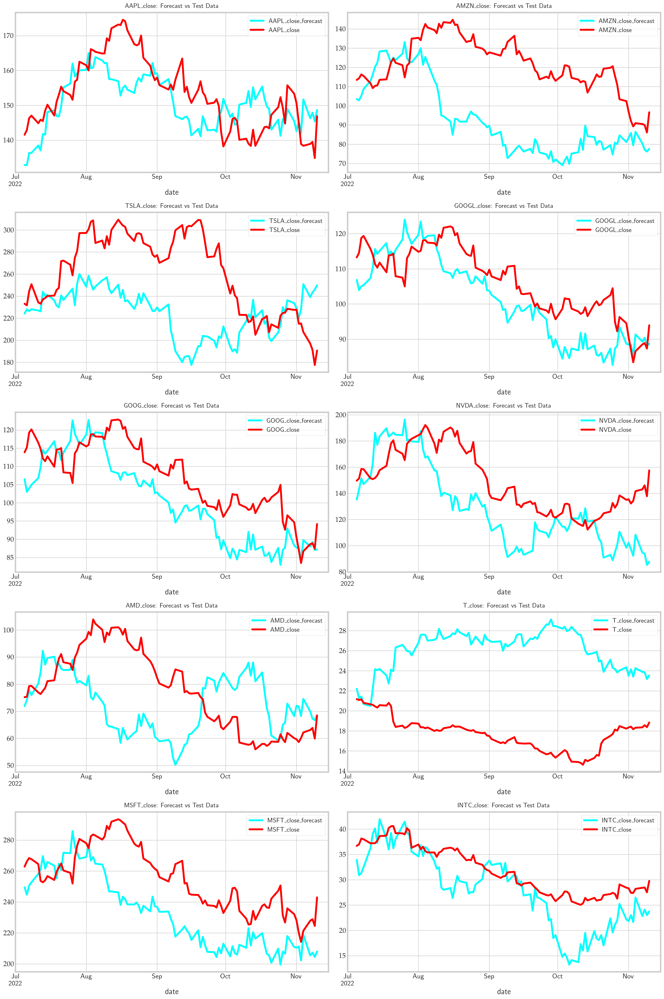

In [81]:
fig, axes = pl.subplots(nrows=5, ncols=2, figsize=(20,30))
loop_columns = df_tech[VAR_cols].set_index('date').columns

for col, ax in zip(loop_columns, axes.flatten()):
    
    df_results[col + '_forecast'].plot(legend=True, color='cyan', ax=ax).autoscale(axis='x',tight=True)
    test.set_index('date')[col].plot(legend=True, color='red', ax=ax)
    ax.set_xlim([pd.to_datetime('2022-07-01'), pd.to_datetime('2022-11-15')])
    ax.set_title(col + ": Forecast vs Test Data")
    ax.tick_params(labelsize=15)

In [85]:
def adjust(val, length=6): return str(val).ljust(length)

for i, j in zip(df_results.columns[len(VAR_cols) - 1:], test[close_columns].columns[1:]):
    print('-----'*4)
    print(f'{j} Analysis')
    
    accuracy_prod = forecast_accuracy(df_results[i].values, test[j].values)
    
    for k, v in accuracy_prod.items():
        print(adjust(k), ': ', round(v, 3))

--------------------
AAPL_close Analysis
MAPSE  :  0.048
ME     :  -2.791
MAE    :  7.324
MPE    :  -0.016
RMSE   :  8.833
CORR   :  0.575
SSE    :  7177.459
--------------------
AMZN_close Analysis
MAPSE  :  0.243
ME     :  -27.787
MAE    :  29.914
MPE    :  -0.224
RMSE   :  34.373
CORR   :  0.259
SSE    :  108699.174
--------------------
TSLA_close Analysis
MAPSE  :  0.158
ME     :  -35.599
MAE    :  43.459
MPE    :  -0.119
RMSE   :  55.023
CORR   :  -0.034
SSE    :  278535.876
--------------------
GOOGL_close Analysis
MAPSE  :  0.068
ME     :  -5.09
MAE    :  7.269
MPE    :  -0.048
RMSE   :  8.85
CORR   :  0.792
SSE    :  7206.096
--------------------
GOOG_close Analysis
MAPSE  :  0.074
ME     :  -6.383
MAE    :  7.89
MPE    :  -0.06
RMSE   :  9.515
CORR   :  0.796
SSE    :  8329.45
--------------------
NVDA_close Analysis
MAPSE  :  0.168
ME     :  -19.699
MAE    :  25.051
MPE    :  -0.133
RMSE   :  29.949
CORR   :  0.694
SSE    :  82521.145
--------------------
AMD_close Analysis
M